In [3]:
import os
import sys

## 定数定義

In [4]:
class Const:
    def __init__(self):
        self.local_mode()
        # self.gcp_mode()
        # self.kaggle_mode()
        # self.colab_mode()

    def local_mode(self):
        # for local
        from pathlib import Path
        home = str(Path.home())
        self.BASE_DIR = f"{home}/enefit-predict/"

        self.set_const()
        sys.path.append(self.INPUT_DIR)

    def gcp_mode(self):
        # for VM Instance
        self.BASE_DIR = "/tmp/working/enefit-predict/"

        self.set_const()

        sys.path.append(self.INPUT_DIR)

    def kaggle_mode(self):
        self.BASE_DIR = f"/kaggle/"

        self.set_const()
        sys.path.append(self.INPUT_DIR)

    def colab_mode(self):
        # for colab
        self.COLAB_DIR = "/content/drive/MyDrive/Colab Notebooks/"
        self.BASE_DIR = f"{self.COLAB_DIR}Enefit - Predict Energy Behavior of Prosumers/"

        from google.colab import drive
        # Gドライブをマウント
        drive.mount('/content/drive')
        # フォルダ移動
        _colab_dir = "/content/drive/MyDrive/Colab Notebooks/"
        os.chdir(os.path.join(_colab_dir, _colab_dir))
        print("current directory is " + os.getcwd())

        self.set_const()

        sys.path.append("/content/drive/MyDrive/Colab Notebooks/my-modules/")
        sys.path.append(self.INPUT_DIR)
        !pip install optuna
        !pip install polars==0.20

    def set_const(self):
        # for common
        ## input
        self.INPUT_DIR = f"{self.BASE_DIR}input/predict-energy-behavior-of-prosumers/"

        ## work
        ### directory
        self.WORK_DIR = f"{self.BASE_DIR}working/"

        ## output
        ### directory
        self.OUTPUT_DIR = f"{self.BASE_DIR}output/"
        ### file
        self.SUBMISSION_FILE = f"{self.OUTPUT_DIR}submission.csv"

const = Const()

In [5]:
# outputフォルダ作成
if not os.path.exists(const.INPUT_DIR):
    os.makedirs(const.INPUT_DIR)
if not os.path.exists(const.OUTPUT_DIR):
    os.makedirs(const.OUTPUT_DIR)
if not os.path.exists(const.WORK_DIR):
    os.makedirs(const.WORK_DIR)


## ライブラリ・変数定義

In [6]:
import decimal
import time
from IPython.display import clear_output # clear_output(True)で出力を全てクリア
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sklearn
import seaborn as sns
import missingno
import plotly.offline as py
py.init_notebook_mode(connected=False)
# import tsfresh

import warnings

warnings.filterwarnings("ignore")
import gc
import pickle

import polars as pl
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sklearn.ensemble import VotingRegressor
from sklearn.model_selection import KFold
import lightgbm as lgb
import optuna

import holidays
import datetime

import math
import ctypes
import random
import tensorflow as tf, deeptables as dt
from tensorflow.keras.utils import plot_model
from tensorflow_addons.optimizers import AdamW
from tensorflow.python.keras import backend as K
from deeptables.models import DeepTable, ModelConfig
from deeptables.models import deepnets

print('TensorFlow version:',tf.__version__)
print('DeepTables version:',dt.__version__)


%matplotlib inline
pd.set_option('display.max_rows', 100) # 表示する最大行数を100に設定
pd.set_option('display.max_columns', 100) # 表示する最大行数を100に設定


TensorFlow version: 2.15.0
DeepTables version: 0.2.6


In [7]:
seed = 42
def seed_everything(seed):
    os.environ['PYTHONHASHSEED'] = str(seed)
    random.seed(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)
seed_everything(seed=seed)

def clean_memory():
    gc.collect()
    # ctypes.CDLL("libc.so.6").malloc_trim(0)
def devide_cp(df):
    con_df = df[df["is_consumption"]==1]
    pro_df = df[df["is_consumption"]==0]
    return con_df, pro_df

clean_memory()

# 00.クラス定義

## 00-1.DataStorage

In [8]:
class DataStorage:
    root = const.INPUT_DIR

    data_cols = [
        "target",
        "county",
        "is_business",
        "product_type",
        "is_consumption",
        "datetime",
        "row_id",
    ]
    client_cols = [
        "product_type",
        "county",
        "eic_count",
        "installed_capacity",
        "is_business",
        "date",
    ]
    gas_prices_cols = ["forecast_date", "lowest_price_per_mwh", "highest_price_per_mwh"]
    electricity_prices_cols = ["forecast_date", "euros_per_mwh"]
    forecast_weather_cols = [
        "latitude",
        "longitude",
        "hours_ahead",
        "temperature",
        "dewpoint",
        "cloudcover_high",
        "cloudcover_low",
        "cloudcover_mid",
        "cloudcover_total",
        "10_metre_u_wind_component",
        "10_metre_v_wind_component",
        "forecast_datetime",
        "direct_solar_radiation",
        "surface_solar_radiation_downwards",
        "snowfall",
        "total_precipitation",
    ]
    historical_weather_cols = [
        "datetime",
        "temperature",
        "dewpoint",
        "rain",
        "snowfall",
        "surface_pressure",
        "cloudcover_total",
        "cloudcover_low",
        "cloudcover_mid",
        "cloudcover_high",
        "windspeed_10m",
        "winddirection_10m",
        "shortwave_radiation",
        "direct_solar_radiation",
        "diffuse_radiation",
        "latitude",
        "longitude",
    ]
    location_cols = ["longitude", "latitude", "county"]
    target_cols = [
        "target",
        "county",
        "is_business",
        "product_type",
        "is_consumption",
        "datetime",
    ]

    def __init__(self):
        self.df_data = pl.read_csv(
            os.path.join(self.root, "train.csv"),
            columns=self.data_cols,
            try_parse_dates=True,
        )
        self.df_client = pl.read_csv(
            os.path.join(self.root, "client.csv"),
            columns=self.client_cols,
            try_parse_dates=True,
        )
        self.df_gas_prices = pl.read_csv(
            os.path.join(self.root, "gas_prices.csv"),
            columns=self.gas_prices_cols,
            try_parse_dates=True,
        )
        self.df_electricity_prices = pl.read_csv(
            os.path.join(self.root, "electricity_prices.csv"),
            columns=self.electricity_prices_cols,
            try_parse_dates=True,
        )
        self.df_forecast_weather = pl.read_csv(
            os.path.join(self.root, "forecast_weather.csv"),
            columns=self.forecast_weather_cols,
            try_parse_dates=True,
        )
        self.df_historical_weather = pl.read_csv(
            os.path.join(self.root, "historical_weather.csv"),
            columns=self.historical_weather_cols,
            try_parse_dates=True,
        )
        self.df_weather_station_to_county_mapping = pl.read_csv(
            os.path.join(self.root, "weather_station_to_county_mapping.csv"),
            columns=self.location_cols,
            try_parse_dates=True,
        )
        self.df_data = self.df_data.filter(
            pl.col("datetime") >= pd.to_datetime("2022-01-01")
        )
        self.df_target = self.df_data.select(self.target_cols)

        self.schema_data = self.df_data.schema
        self.schema_client = self.df_client.schema
        self.schema_gas_prices = self.df_gas_prices.schema
        self.schema_electricity_prices = self.df_electricity_prices.schema
        self.schema_forecast_weather = self.df_forecast_weather.schema
        self.schema_historical_weather = self.df_historical_weather.schema
        self.schema_target = self.df_target.schema

        self.df_weather_station_to_county_mapping = (
            self.df_weather_station_to_county_mapping.with_columns(
                pl.col("latitude").cast(pl.datatypes.Float32),
                pl.col("longitude").cast(pl.datatypes.Float32),
            )
        )

    def update_with_new_data(
        self,
        df_new_client,
        df_new_gas_prices,
        df_new_electricity_prices,
        df_new_forecast_weather,
        df_new_historical_weather,
        df_new_target,
    ):
        df_new_client = pl.from_pandas(
            df_new_client[self.client_cols], schema_overrides=self.schema_client
        )
        df_new_gas_prices = pl.from_pandas(
            df_new_gas_prices[self.gas_prices_cols],
            schema_overrides=self.schema_gas_prices,
        )
        df_new_electricity_prices = pl.from_pandas(
            df_new_electricity_prices[self.electricity_prices_cols],
            schema_overrides=self.schema_electricity_prices,
        )
        df_new_forecast_weather = pl.from_pandas(
            df_new_forecast_weather[self.forecast_weather_cols],
            schema_overrides=self.schema_forecast_weather,
        )
        df_new_historical_weather = pl.from_pandas(
            df_new_historical_weather[self.historical_weather_cols],
            schema_overrides=self.schema_historical_weather,
        )
        df_new_target = pl.from_pandas(
            df_new_target[self.target_cols], schema_overrides=self.schema_target
        )

        self.df_client = pl.concat([self.df_client, df_new_client]).unique(
            ["date", "county", "is_business", "product_type"]
        )
        self.df_gas_prices = pl.concat([self.df_gas_prices, df_new_gas_prices]).unique(
            ["forecast_date"]
        )
        self.df_electricity_prices = pl.concat(
            [self.df_electricity_prices, df_new_electricity_prices]
        ).unique(["forecast_date"])
        self.df_forecast_weather = pl.concat(
            [self.df_forecast_weather, df_new_forecast_weather]
        ).unique(["forecast_datetime", "latitude", "longitude", "hours_ahead"])
        self.df_historical_weather = pl.concat(
            [self.df_historical_weather, df_new_historical_weather]
        ).unique(["datetime", "latitude", "longitude"])
        self.df_target = pl.concat([self.df_target, df_new_target]).unique(
            ["datetime", "county", "is_business", "product_type", "is_consumption"]
        )

    def preprocess_test(self, df_test):
        df_test = df_test.rename(columns={"prediction_datetime": "datetime"})
        df_test = pl.from_pandas(
            df_test[self.data_cols[1:]], schema_overrides=self.schema_data
        )
        return df_test


## 00-2.FeaturesGenerator

In [9]:
class FeaturesGenerator:
    def __init__(self, data_storage):
        self.data_storage = data_storage
        self.estonian_holidays = list(
            holidays.country_holidays("EE", years=range(2021, 2026)).keys()
        )

    def _add_general_features(self, df_features):
        df_features = (
            df_features.with_columns(
                pl.col("datetime").dt.ordinal_day().alias("dayofyear"),
                pl.col("datetime").dt.hour().alias("hour"),
                pl.col("datetime").dt.day().alias("day"),
                pl.col("datetime").dt.weekday().alias("weekday"),
                pl.col("datetime").dt.month().alias("month"),
                pl.col("datetime").dt.year().alias("year"),
            )
            .with_columns(
                pl.concat_str(
                    "county",
                    "is_business",
                    "product_type",
                    "is_consumption",
                    separator="_",
                ).alias("segment"),
            )
            .with_columns(
                (np.pi * pl.col("dayofyear") / 183).sin().alias("sin(dayofyear)"),
                (np.pi * pl.col("dayofyear") / 183).cos().alias("cos(dayofyear)"),
                # (np.pi * pl.col("month") / 6).sin().alias("sin(month)"),
                # (np.pi * pl.col("month") / 6).cos().alias("cos(month)"),
                (np.pi * pl.col("hour") / 12).sin().alias("sin(hour)"),
                (np.pi * pl.col("hour") / 12).cos().alias("cos(hour)"),
            )
        )
        return df_features

    def _add_client_features(self, df_features):
        df_client = self.data_storage.df_client

        df_features = df_features.join(
            df_client.with_columns(
                (pl.col("date") + pl.duration(days=2)).cast(pl.Date)
            ),
            on=["county", "is_business", "product_type", "date"],
            how="left",
        )
        return df_features
    
    def is_country_holiday(self, row):
        return (
            datetime.date(row["year"], row["month"], row["day"])
            in self.estonian_holidays
        )

    def _add_holidays_features(self, df_features):
        df_features = df_features.with_columns(
            pl.struct(["year", "month", "day"])
            .apply(self.is_country_holiday)
            .alias("is_country_holiday")
        )
        df_features = df_features.with_columns(
            pl.when(pl.col("weekday") >= 6)
            .then(True)
            .otherwise(pl.col("is_country_holiday"))
            .alias("is_country_holiday")
        )
        return df_features

    def _add_forecast_weather_features(self, df_features):
        df_forecast_weather = self.data_storage.df_forecast_weather
        df_weather_station_to_county_mapping = (
            self.data_storage.df_weather_station_to_county_mapping
        )

        df_forecast_weather = (
            df_forecast_weather.rename({"forecast_datetime": "datetime"})
            .filter((pl.col("hours_ahead") >= 22) & pl.col("hours_ahead") <= 45)
            .drop("hours_ahead")
            .with_columns(
                pl.col("latitude").cast(pl.datatypes.Float32),
                pl.col("longitude").cast(pl.datatypes.Float32),
            )
            .join(
                df_weather_station_to_county_mapping,
                how="left",
                on=["longitude", "latitude"],
            )
            .drop("longitude", "latitude")
            .with_columns(
                (pl.col("10_metre_u_wind_component")**2 + pl.col("10_metre_v_wind_component")**2).sqrt().alias("windspeed_10m_forecast"),
                (pl.col("10_metre_v_wind_component")/(pl.col("10_metre_u_wind_component")**2 + pl.col("10_metre_v_wind_component")**2).sqrt()).alias("sin(winddirection_10m_forecast)"),
                (pl.col("10_metre_u_wind_component")/(pl.col("10_metre_u_wind_component")**2 + pl.col("10_metre_v_wind_component")**2).sqrt()).alias("cos(winddirection_10m_forecast)"),
            )
            # .drop("10_metre_u_wind_component", "10_metre_v_wind_component")
        )

        df_forecast_weather_date = (
            df_forecast_weather.group_by("datetime").mean().drop("county")
        )

        df_forecast_weather_local = (
            df_forecast_weather.filter(pl.col("county").is_not_null())
            .group_by("county", "datetime")
            .mean()
        )

        for hours_lag in [0, 7 * 24]:
            df_features = df_features.join(
                df_forecast_weather_date.with_columns(
                    pl.col("datetime") + pl.duration(hours=hours_lag)
                ),
                on="datetime",
                how="left",
                suffix=f"_forecast_{hours_lag}h",
            )
            df_features = df_features.join(
                df_forecast_weather_local.with_columns(
                    pl.col("datetime") + pl.duration(hours=hours_lag)
                ),
                on=["county", "datetime"],
                how="left",
                suffix=f"_forecast_local_{hours_lag}h",
            )

        return df_features

    def _add_historical_weather_features(self, df_features):
        df_historical_weather = self.data_storage.df_historical_weather
        df_weather_station_to_county_mapping = (
            self.data_storage.df_weather_station_to_county_mapping
        )

        df_historical_weather = (
            df_historical_weather.with_columns(
                pl.col("latitude").cast(pl.datatypes.Float32),
                pl.col("longitude").cast(pl.datatypes.Float32),
            )
            .join(
                df_weather_station_to_county_mapping,
                how="left",
                on=["longitude", "latitude"],
            )
            .drop("longitude", "latitude")
            .with_columns(
                # ((pl.col("winddirection_10m") - 90) * (-math.pi/180)).sin().alias("sin(winddirection_10m)"),
                # ((pl.col("winddirection_10m") - 90) * (-math.pi/180)).cos().alias("cos(winddirection_10m)"),
                ((pl.col("winddirection_10m") * (math.pi/180)).sin()*(-1)).alias("sin(winddirection_10m)"),
                ((pl.col("winddirection_10m") * (math.pi/180)).cos()*(-1)).alias("cos(winddirection_10m)"),
            )
            # .drop("winddirection_10m")
        )

        df_historical_weather_date = (
            df_historical_weather.group_by("datetime").mean().drop("county")
        )

        df_historical_weather_local = (
            df_historical_weather.filter(pl.col("county").is_not_null())
            .group_by("county", "datetime")
            .mean()
        )

        for hours_lag in [2 * 24, 7 * 24]:
            df_features = df_features.join(
                df_historical_weather_date.with_columns(
                    pl.col("datetime") + pl.duration(hours=hours_lag)
                ),
                on="datetime",
                how="left",
                suffix=f"_historical_{hours_lag}h",
            )
            df_features = df_features.join(
                df_historical_weather_local.with_columns(
                    pl.col("datetime") + pl.duration(hours=hours_lag)
                ),
                on=["county", "datetime"],
                how="left",
                suffix=f"_historical_local_{hours_lag}h",
            )

        for hours_lag in [1 * 24]:
            df_features = df_features.join(
                df_historical_weather_date.with_columns(
                    pl.col("datetime") + pl.duration(hours=hours_lag),
                    pl.col("datetime").dt.hour().alias("hour"),
                )
                .filter(pl.col("hour") <= 10)
                .drop("hour"),
                on="datetime",
                how="left",
                suffix=f"_historical_{hours_lag}h",
            )

        return df_features

    def _add_target_features(self, df_features):
        df_target = self.data_storage.df_target

        df_target_all_type_sum = (
            df_target.group_by(["datetime", "county", "is_business", "is_consumption"])
            .sum()
            .drop("product_type")
        )

        df_target_all_county_type_sum = (
            df_target.group_by(["datetime", "is_business", "is_consumption"])
            .sum()
            .drop("product_type", "county")
        )

        for hours_lag in [
            2 * 24,
            3 * 24,
            4 * 24,
            5 * 24,
            6 * 24,
            7 * 24,
            8 * 24,
            9 * 24,
            10 * 24,
            11 * 24,
            12 * 24,
            13 * 24,
            14 * 24,
        ]:
            df_features = df_features.join(
                df_target.with_columns(
                    pl.col("datetime") + pl.duration(hours=hours_lag)
                ).rename({"target": f"target_{hours_lag}h"}),
                on=[
                    "county",
                    "is_business",
                    "product_type",
                    "is_consumption",
                    "datetime",
                ],
                how="left",
            )

        for hours_lag in [2 * 24, 3 * 24, 7 * 24, 14 * 24]:
            df_features = df_features.join(
                df_target_all_type_sum.with_columns(
                    pl.col("datetime") + pl.duration(hours=hours_lag)
                ).rename({"target": f"target_all_type_sum_{hours_lag}h"}),
                on=["county", "is_business", "is_consumption", "datetime"],
                how="left",
            )

            df_features = df_features.join(
                df_target_all_county_type_sum.with_columns(
                    pl.col("datetime") + pl.duration(hours=hours_lag)
                ).rename({"target": f"target_all_county_type_sum_{hours_lag}h"}),
                on=["is_business", "is_consumption", "datetime"],
                how="left",
                suffix=f"_all_county_type_sum_{hours_lag}h",
            )

        cols_for_stats = [
            f"target_{hours_lag}h" for hours_lag in [2 * 24, 3 * 24, 4 * 24, 5 * 24]
        ]
        df_features = df_features.with_columns(
            df_features.select(cols_for_stats).mean(axis=1).alias(f"target_mean"),
            df_features.select(cols_for_stats)
            .transpose()
            .std()
            .transpose()
            .to_series()
            .alias(f"target_std"),
        )

        for target_prefix, lag_nominator, lag_denomonator in [
            ("target", 24 * 7, 24 * 14),
            ("target", 24 * 2, 24 * 9),
            ("target", 24 * 3, 24 * 10),
            ("target", 24 * 2, 24 * 3),
            ("target_all_type_sum", 24 * 2, 24 * 3),
            ("target_all_type_sum", 24 * 7, 24 * 14),
            ("target_all_county_type_sum", 24 * 2, 24 * 3),
            ("target_all_county_type_sum", 24 * 7, 24 * 14),
        ]:
            df_features = df_features.with_columns(
                (
                    pl.col(f"{target_prefix}_{lag_nominator}h")
                    / (pl.col(f"{target_prefix}_{lag_denomonator}h") + 1e-3)
                ).alias(f"{target_prefix}_ratio_{lag_nominator}_{lag_denomonator}")
            )

        return df_features

    def _reduce_memory_usage(self, df_features):
        df_features = df_features.with_columns(pl.col(pl.Float64).cast(pl.Float32))
        return df_features

    def _drop_columns(self, df_features):
        df_features = df_features.drop(
            "date",
            "datetime",
            "hour",
            "dayofyear",
            "target_mean",
            "target_std",
        )
        return df_features

    def _to_pandas(self, df_features, y):
        cat_cols = [
            "county",
            "is_business",
            "product_type",
            "is_consumption",
            "segment",
        ]

        if y is not None:
            df_features = pd.concat([df_features.to_pandas(), y.to_pandas()], axis=1)
        else:
            df_features = df_features.to_pandas()

        df_features = df_features.set_index("row_id")
        df_features[cat_cols] = df_features[cat_cols].astype("category")

        return df_features

    def _additional_features(self,df):
        for col in [
                    'temperature', 
                    'dewpoint', 
                    '10_metre_u_wind_component', 
                    '10_metre_v_wind_component', 
            ]:
            for window in [1]:
                df[f"{col}_diff_{window}"] = df.groupby(["county", 'is_consumption', 'product_type', 'is_business'])[col].diff(window)
        df["windspeed_diff_act_forecast"] = df["windspeed_10m_forecast"] - df["windspeed_10m"]
        df["winddirsin_diff_act_forecast"] = df["sin(winddirection_10m_forecast)"] - df["sin(winddirection_10m)"]
        df["winddircos_diff_act_forecast"] = df["cos(winddirection_10m_forecast)"] - df["cos(winddirection_10m)"]
        return df
    
    def _add_log_features(self,df_features):
        log_list = ['target_mean', 'target_std',]
        
        for i in log_list:
            
            df_features = df_features.with_columns(
                (
                    pl.when(df_features[i] != 0).then(np.log(pl.col(i))).otherwise(0)
                ).alias(f"log_{i}")
            )
        
        return df_features
        
    def generate_features(self, df_prediction_items):
        if "target" in df_prediction_items.columns:
            df_prediction_items, y = (
                df_prediction_items.drop("target"),
                df_prediction_items.select("target"),
            )
        else:
            y = None

        df_features = df_prediction_items.with_columns(
            pl.col("datetime").cast(pl.Date).alias("date"),
        )

        for add_features in [
            self._add_general_features,
            self._add_client_features,
            self._add_forecast_weather_features,
            self._add_historical_weather_features,
            self._add_target_features,
            self._add_holidays_features,
            self._add_log_features,
            self._reduce_memory_usage,
            self._drop_columns,
        ]:
            df_features = add_features(df_features)

        df_features = self._to_pandas(df_features, y)
        df_features = self._additional_features(df_features)

        return df_features

# 01.Initialisation

In [10]:
%%time

data_storage = DataStorage()
features_generator = FeaturesGenerator(data_storage=data_storage)

CPU times: total: 6.59 s
Wall time: 1.67 s


# 02.Feature Generation

In [11]:
%%time

df_train_features = features_generator.generate_features(data_storage.df_data)
df_train_features = df_train_features[df_train_features['target'].notnull()]

CPU times: total: 58.7 s
Wall time: 21.5 s


# 03.Train Model

### LearningRateScheduler

Learning rate schedule: 1e-07 to 0.001 to 1e-07


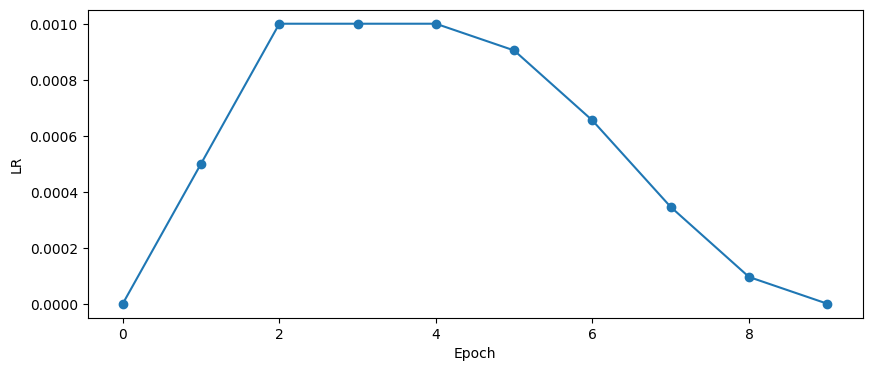

In [12]:
LR_START = 1e-7
LR_MAX = 1e-3
LR_MIN = 1e-7
LR_RAMPUP_EPOCHS = 2
LR_SUSTAIN_EPOCHS = 2
EPOCHS = 10

def lrfn(epoch):
    if epoch < LR_RAMPUP_EPOCHS:
        lr = (LR_MAX - LR_START) / LR_RAMPUP_EPOCHS * epoch + LR_START
    elif epoch < LR_RAMPUP_EPOCHS + LR_SUSTAIN_EPOCHS:
        lr = LR_MAX
    else:
        decay_total_epochs = EPOCHS - LR_RAMPUP_EPOCHS - LR_SUSTAIN_EPOCHS - 1
        decay_epoch_index = epoch - LR_RAMPUP_EPOCHS - LR_SUSTAIN_EPOCHS
        phase = math.pi * decay_epoch_index / decay_total_epochs
        cosine_decay = 0.5 * (1 + math.cos(phase))
        lr = (LR_MAX - LR_MIN) * cosine_decay + LR_MIN
        
    return lr

rng = [i for i in range(EPOCHS)]
lr_y = [lrfn(x) for x in rng]
plt.figure(figsize=(10, 4))
plt.plot(rng, lr_y, '-o')
plt.xlabel('Epoch'); plt.ylabel('LR')
print("Learning rate schedule: {:.3g} to {:.3g} to {:.3g}". \
      format(lr_y[0], max(lr_y), lr_y[-1]))
LR = tf.keras.callbacks.LearningRateScheduler(lrfn, verbose = True)

In [13]:
class CFG:
    nn = True
    lgb = True
    ens_weights = {'nn': 0.4, 'lgb': 0.6}
    epochs = 10
    batch_size = 512
    valid_size = 5e-2
    LR_Scheduler = []  # [LR]
    optimizer = AdamW(learning_rate=1e-3, weight_decay=9e-7)
     
class Model:
    def __init__(self, lgb_learning_step=10):
        self.set_lgb_learning_step(lgb_learning_step)
        self.conf = ModelConfig(auto_imputation=True,
                                auto_discrete=True,
                                auto_discard_unique=True,
                                categorical_columns='auto',
                                fixed_embedding_dim=False,
                                embeddings_output_dim=4,
                                embedding_dropout=0.3,
                                nets=['dnn_nets'],
                                dnn_params={
                                    'hidden_units': ((512, 0.3, True),
                                                     (256, 0.3, True)),
                                    'dnn_activation': 'relu',
                                },
                                stacking_op='add',
                                output_use_bias=False,
                                optimizer=CFG.optimizer,
                                task='regression',
                                loss='MeanAbsoluteError',
                                metrics='MeanAbsoluteError',
                                earlystopping_patience=1,
                                )
        
        self.lgb_params = {"n_estimators": 2500,
                           "learning_rate": 0.06,
                           "max_depth": 16,
                           "num_leaves": 500,
                           "reg_alpha": 3.5,
                           "reg_lambda": 1.5,
                           "colsample_bytree": 0.9,
                           "colsample_bynode": 0.6,
                           "min_child_samples": 50,
                           "objective": "regression_l1",
                           "device": "gpu",
                           "n_jobs": 4,
                           "verbose": -1,
                           }
        self.nn_model_consumption = DeepTable(config=self.conf)  
        self.nn_model_production = DeepTable(config=self.conf)
        
        self.lgb_model_consumption = VotingRegressor(
            [
                (
                    f"consumption_lgb_{i}",
                    lgb.LGBMRegressor(**self.lgb_params, random_state=i),
                )
                for i in range(self.lgb_learning_step)
            ]
        )
        self.lgb_model_production = VotingRegressor(
            [
                (
                    f"production_lgb_{i}",
                    lgb.LGBMRegressor(**self.lgb_params, random_state=i),
                )
                for i in range(self.lgb_learning_step)
            ]
        )
        
    def set_lgb_learning_step(self, lgb_learning_step):
        self.lgb_learning_step = lgb_learning_step
        
    def fit(self, df_train_features):
        print('nn = '+str(CFG.nn))
        print('lgb = '+str(CFG.lgb))
        
        if CFG.nn == True:
            
            print('\n',"nn model consumption training.",'\n')
            mask = df_train_features["is_consumption"] == 1
            self.nn_model_consumption.fit(
                X=df_train_features[mask].drop(columns=["target"]),
                y=df_train_features[mask]["target"]
                - df_train_features[mask]["target_48h"].fillna(0),
                validation_split=CFG.valid_size, shuffle=False,
                batch_size=CFG.batch_size, epochs=CFG.epochs, verbose=2,
                callbacks=CFG.LR_Scheduler
            )
        
            # Avoid saving error
            with K.name_scope(CFG.optimizer.__class__.__name__):
                for i, var in enumerate(CFG.optimizer.weights):
                    name = 'variable{}'.format(i)
                    CFG.optimizer.weights[i] = tf.Variable(var, name=name)
            self.conf = self.conf._replace(optimizer=CFG.optimizer)   
            self.nn_model_production = DeepTable(config=self.conf)
            
            print('\n',"nn model production training.",'\n')
            mask = df_train_features["is_consumption"] == 0
            self.nn_model_production.fit(
                X=df_train_features[mask].drop(columns=["target"]),
                y=df_train_features[mask]["target"]
                - df_train_features[mask]["target_48h"].fillna(0),
                validation_split=CFG.valid_size, shuffle=False,
                batch_size=CFG.batch_size, epochs=CFG.epochs, verbose=2,
                callbacks=CFG.LR_Scheduler
            )
        
        if CFG.lgb == True:
            
            print('\n',"lgb model consumption training.")
            mask = df_train_features["is_consumption"] == 1
            self.lgb_model_consumption.fit(
                X=df_train_features[mask].drop(columns=["target"]),
                y=df_train_features[mask]["target"]
                - df_train_features[mask]["target_48h"].fillna(0),
            )
        
            print('\n',"lgb model production training.",'\n')
            mask = df_train_features["is_consumption"] == 0
            self.lgb_model_production.fit(
                X=df_train_features[mask].drop(columns=["target"]),
                y=df_train_features[mask]["target"]
                - df_train_features[mask]["target_48h"].fillna(0),
            )
        
    def plot_nn_model(self):
        if CFG.nn == True:
            return plot_model(self.nn_model_consumption.get_model().model)    

    def predict(self, df_features):
        predictions = np.zeros(len(df_features))
        
        if CFG.nn == True and CFG.lgb == True:
            
            print('\n',"nn & lgb model consumption prediction.",'\n')
            mask = df_features["is_consumption"] == 1
            predictions[mask.values] = np.clip(
                df_features[mask]["target_48h"].fillna(0).values
                + CFG.ens_weights['nn'] * (self.nn_model_consumption.predict(df_features[mask])[:,0])
                + CFG.ens_weights['lgb'] * (self.lgb_model_consumption.predict(df_features[mask])),
                0,
                np.inf,
            )
        
            print('\n',"nn & lgb model production prediction.",'\n')
            mask = df_features["is_consumption"] == 0
            predictions[mask.values] = np.clip(
                df_features[mask]["target_48h"].fillna(0).values
                + CFG.ens_weights['nn'] * (self.nn_model_production.predict(df_features[mask])[:,0])
                + CFG.ens_weights['lgb'] * (self.lgb_model_production.predict(df_features[mask])),
                0,
                np.inf,
            )
        
        elif CFG.nn == True and CFG.lgb == False:
            
            print('\n',"nn model consumption prediction.",'\n')
            mask = df_features["is_consumption"] == 1
            predictions[mask.values] = np.clip(
                df_features[mask]["target_48h"].fillna(0).values
                + self.nn_model_consumption.predict(df_features[mask])[:,0],
                0,
                np.inf,
            )
            
            print('\n',"nn model production prediction.",'\n')
            mask = df_features["is_consumption"] == 0
            predictions[mask.values] = np.clip(
                df_features[mask]["target_48h"].fillna(0).values
                + self.nn_model_production.predict(df_features[mask])[:,0],
                0,
                np.inf,
            )
            
        elif CFG.nn == False and CFG.lgb == True:
            
            print('\n',"lgb model consumption prediction.",'\n')
            mask = df_features["is_consumption"] == 1
            predictions[mask.values] = np.clip(
                df_features[mask]["target_48h"].fillna(0).values
                + self.lgb_model_consumption.predict(df_features[mask]),
                0,
                np.inf,
            )
            
            print('\n',"lgb model production prediction.",'\n')
            mask = df_features["is_consumption"] == 0
            predictions[mask.values] = np.clip(
                df_features[mask]["target_48h"].fillna(0).values
                + self.lgb_model_production.predict(df_features[mask]),
                0,
                np.inf,
            )
            
        else:
            raise ValueError("No models has been trained.")
            
        return predictions
    


In [11]:
%%time

model = Model(10)
model.fit(df_train_features)
clean_memory()
model.plot_nn_model()


start
start consumption
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] lambda_l1 is set=3.5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5
[LightGBM] [Warning] lambda_l2 is set=1.5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] lambda_l1 is set=3.5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5
[LightGBM] [Warning] lambda_l2 is set=1.5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 39557
[LightGBM] [Info] Number of data points in the train set: 825951, number of used features: 168
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce GTX 1660, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins.

# 04.Submit API

In [13]:
import enefit
env = enefit.make_env()
iter_test = env.iter_test()

ModuleNotFoundError: No module named 'enefit.competition'

In [28]:
for (
    df_test,
    df_new_target,
    df_new_client,
    df_new_historical_weather,
    df_new_forecast_weather,
    df_new_electricity_prices,
    df_new_gas_prices,
    df_sample_prediction
) in iter_test:

    data_storage.update_with_new_data(
        df_new_client=df_new_client,
        df_new_gas_prices=df_new_gas_prices,
        df_new_electricity_prices=df_new_electricity_prices,
        df_new_forecast_weather=df_new_forecast_weather,
        df_new_historical_weather=df_new_historical_weather,
        df_new_target=df_new_target
    )
    df_test = data_storage.preprocess_test(df_test)

    df_test_features = features_generator.generate_features(df_test)
    df_sample_prediction["target"] = model.predict(df_test_features)

    env.predict(df_sample_prediction)

ModuleNotFoundError: No module named 'enefit.competition'

# 99.my work

In [21]:
print(*df_train_features.columns[:], sep="\n")

county
is_business
product_type
is_consumption
day
weekday
month
year
segment
sin(dayofyear)
cos(dayofyear)
sin(hour)
cos(hour)
temperature
dewpoint
cloudcover_high
cloudcover_low
cloudcover_mid
cloudcover_total
10_metre_u_wind_component
10_metre_v_wind_component
direct_solar_radiation
surface_solar_radiation_downwards
snowfall
total_precipitation
temperature_forecast_local_0h
dewpoint_forecast_local_0h
cloudcover_high_forecast_local_0h
cloudcover_low_forecast_local_0h
cloudcover_mid_forecast_local_0h
cloudcover_total_forecast_local_0h
10_metre_u_wind_component_forecast_local_0h
10_metre_v_wind_component_forecast_local_0h
direct_solar_radiation_forecast_local_0h
surface_solar_radiation_downwards_forecast_local_0h
snowfall_forecast_local_0h
total_precipitation_forecast_local_0h
temperature_forecast_168h
dewpoint_forecast_168h
cloudcover_high_forecast_168h
cloudcover_low_forecast_168h
cloudcover_mid_forecast_168h
cloudcover_total_forecast_168h
10_metre_u_wind_component_forecast_168h
10_m

## 99-1.モデル保存・読み込み

In [12]:
# model_filepath_consumption = os.path.join(const.WORK_DIR, 'model_consumption.pkl')
# model_filepath_production = os.path.join(const.WORK_DIR, 'model_production.pkl')
model_filepath_consumption = os.path.join(const.WORK_DIR, '1model_48hourdiff_sinmonth_newcapa/model_consumption.pkl')
model_filepath_production = os.path.join(const.WORK_DIR, '1model_48hourdiff_sinmonth_newcapa/model_production.pkl')

# list_model_filepath_consumption = [os.path.join(const.WORK_DIR, f'10model_x_hourdiff/model_consumption_{i*24}h.pkl') for i in range(2, 14)]
# list_model_filepath_production = [os.path.join(const.WORK_DIR, f'10model_x_hourdiff/model_production_{i*24}h.pkl') for i in range(2, 14)]



In [13]:
# 構築したモデルの保存
pickle.dump(model.model_consumption,open(model_filepath_consumption,'wb'))
pickle.dump(model.model_production,open(model_filepath_production,'wb'))

# for i, model_filepath_consumption in enumerate(list_model_filepath_consumption):
#     pickle.dump(model.model_consumption[i],open(model_filepath_consumption,'wb'))
# for i, model_filepath_production in enumerate(list_model_filepath_production):
#     pickle.dump(model.model_production[i],open(model_filepath_production,'wb'))


In [17]:
# 保存したモデルの読み込み
class reserved_model(Model):
    def __init__(self):
        self.model_consumption = pickle.load(open(model_filepath_consumption, 'rb'))
        self.model_production = pickle.load(open(model_filepath_production, 'rb'))

# class reserved_model(Model):
#     def __init__(self):
#         self.ensamble_num = 12
#         self.model_consumption = []
#         self.model_production = []
#         for i, model_filepath_consumption in enumerate(list_model_filepath_consumption):
#             self.model_consumption.append(pickle.load(open(model_filepath_consumption, 'rb')))
#         for i, model_filepath_production in enumerate(list_model_filepath_production):
#             self.model_production.append(pickle.load(open(model_filepath_production, 'rb')))

model = reserved_model()

In [31]:
# feature importanceの書き込み
## consumption
feature_filepath_consumption = os.path.join(const.WORK_DIR, 'feature_importance_consumption.txt')
with open(feature_filepath_consumption, 'w') as f:
    feature_importace = pd.Series(model.lgb_model_consumption.estimators_[0].feature_importances_,index=df_train_features.drop("target", axis=1).columns).sort_values(ascending=False)
    for i, v in feature_importace.items():
        f.write(f"{i}\t{v}\n")
print(feature_importace.head(50))
print()
## production
feature_filepath_production = os.path.join(const.WORK_DIR, 'feature_importance_production.txt')
with open(feature_filepath_production, 'w') as f:
    feature_importace = pd.Series(model.lgb_model_production.estimators_[0].feature_importances_,index=df_train_features.drop("target", axis=1).columns).sort_values(ascending=False)
    for i, v in feature_importace.items():
        f.write(f"{i}\t{v}\n")
print(feature_importace.head(50))


segment                                              105911
target_ratio_48_216                                   16265
target_ratio_48_72                                    15051
county                                                14751
target_ratio_72_240                                   14245
target_ratio_168_336                                  13314
target_48h                                            12968
target_all_type_sum_ratio_48_72                       11095
log_target_std                                        11004
target_all_type_sum_ratio_168_336                     10902
windspeed_10m_historical_local_48h                     9920
target_all_county_type_sum_ratio_48_72                 9622
windspeed_10m_forecast_forecast_local_0h               9513
target_336h                                            9501
target_all_county_type_sum_ratio_168_336               9463
10_metre_u_wind_component_diff_1                       9365
surface_pressure_historical_local_48h   

## 99-2.分析

### テストデータ読み込み

In [14]:
data_cols = [
    "county",
    "is_business",
    "product_type",
    "is_consumption",
    "prediction_datetime",
    "row_id",
]
df_test = pl.read_csv(
    os.path.join(const.INPUT_DIR, "example_test_files/test.csv"),
    columns=data_cols,
    try_parse_dates=True,
)

sample_prediction_cols = [
    "target",
    "county",
    "is_business",
    "product_type",
    "is_consumption",
    "datetime",
    "row_id",
]
df_sample_prediction = pl.read_csv(
    os.path.join(const.INPUT_DIR, "example_test_files/revealed_targets.csv"),
    columns=sample_prediction_cols,
    try_parse_dates=True,
)

In [15]:
# df_test = data_storage.preprocess_test(df_test)
df_test = df_test.rename({"prediction_datetime": "datetime"})
# df_test = pl.from_pandas(
#     df_test[data_storage.data_cols[1:]], schema_overrides=data_storage.schema_data
# )

df_test_features = features_generator.generate_features(df_test)


In [10]:
# 学習データの分析を行いたい場合、下記を実行
my_date_str="2022-01-01"
my_date_str_end="2023-02-01"
my_date_fmt="%F"
df_sample_prediction = data_storage.df_data \
                        .filter(pl.col('datetime') >= pl.lit(my_date_str).str.strptime(pl.Date)) \
                        .filter(pl.col('datetime') < pl.lit(my_date_str_end).str.strptime(pl.Date))
df_sample_prediction = df_sample_prediction.drop_nulls()
df_test = df_sample_prediction.drop("target")

df_train_features_filtered = df_train_features[(df_train_features["year"] >= 2022) & (df_train_features["month"] == 1)]
df_test_features = df_train_features_filtered.drop("target", axis=1)

KeyError: 'month'

### 推論

In [16]:
r = model.predict(df_test_features)

[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] lambda_l1 is set=3.5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5
[LightGBM] [Warning] lambda_l2 is set=1.5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5
[LightGBM] [Warning] min_data_in_leaf is set=50, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=50
[LightGBM] [Warning] lambda_l1 is set=3.5, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.5
[LightGBM] [Warning] lambda_l2 is set=1.5, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5


In [17]:
df_test = df_test.with_columns(pl.DataFrame({"target": r}))

In [18]:
df_test

county,is_business,product_type,is_consumption,datetime,row_id,target
i64,i64,i64,i64,datetime[μs],i64,f64
0,0,1,0,2023-05-28 00:00:00,2005872,2.459245
0,0,1,1,2023-05-28 00:00:00,2005873,579.060821
0,0,2,0,2023-05-28 00:00:00,2005874,0.0
0,0,2,1,2023-05-28 00:00:00,2005875,4.311024
0,0,3,0,2023-05-28 00:00:00,2005876,15.93629
0,0,3,1,2023-05-28 00:00:00,2005877,1452.758421
0,1,0,0,2023-05-28 00:00:00,2005878,0.0
0,1,0,1,2023-05-28 00:00:00,2005879,458.731303
0,1,1,0,2023-05-28 00:00:00,2005880,0.0


In [ ]:
# 学習データの分析を行いたい場合、下記を実行
df_filtered_sample_prediction = df_sample_prediction
df_filtered_test = df_test

In [19]:
my_date_str="2023-05-28"
my_date_fmt="%F"
df_filtered_sample_prediction = df_sample_prediction.filter(pl.col('datetime') >= pl.lit(my_date_str).str.strptime(pl.Date))

In [20]:
my_date_str="2023-05-30"
my_date_fmt="%F"
df_filtered_test = df_test.filter(pl.col('datetime') < pl.lit(my_date_str).str.strptime(pl.Date))

### スコア出力

In [21]:
mae_score_consumption = sklearn.metrics.mean_absolute_error(df_filtered_sample_prediction.filter(df_filtered_sample_prediction["is_consumption"] == 1)["target"], df_filtered_test.filter(df_filtered_test["is_consumption"] == 1)["target"])
mae_score_production = sklearn.metrics.mean_absolute_error(df_filtered_sample_prediction.filter(df_filtered_sample_prediction["is_consumption"] == 0)["target"], df_filtered_test.filter(df_filtered_test["is_consumption"] == 0)["target"])

print(f"mae_score_consumption: {mae_score_consumption}")
print(f"mae_score_production: {mae_score_production}")

mae_score_consumption: 19.78011018840234
mae_score_production: 32.94913169948239


In [22]:
mae_filepath = os.path.join(const.WORK_DIR, 'mae_score.txt')
with open(mae_filepath, 'w') as f:
    f.write(f"mae_score_consumption: {mae_score_consumption}\n")
    f.write(f"mae_score_production: {mae_score_production}\n")


### 時系列グラフ

In [16]:
df_train_features

,county,is_business,product_type,is_consumption,day,weekday,month,year,segment,sin(dayofyear),cos(dayofyear),sin(hour),cos(hour),temperature,dewpoint,cloudcover_high,cloudcover_low,cloudcover_mid,cloudcover_total,10_metre_u_wind_component,10_metre_v_wind_component,direct_solar_radiation,surface_solar_radiation_downwards,snowfall,total_precipitation,windspeed_10m_forecast,sin(winddirection_10m_forecast),cos(winddirection_10m_forecast),temperature_forecast_local_0h,dewpoint_forecast_local_0h,cloudcover_high_forecast_local_0h,cloudcover_low_forecast_local_0h,cloudcover_mid_forecast_local_0h,cloudcover_total_forecast_local_0h,10_metre_u_wind_component_forecast_local_0h,10_metre_v_wind_component_forecast_local_0h,direct_solar_radiation_forecast_local_0h,surface_solar_radiation_downwards_forecast_local_0h,snowfall_forecast_local_0h,total_precipitation_forecast_local_0h,windspeed_10m_forecast_forecast_local_0h,sin(winddirection_10m_forecast)_forecast_local_0h,cos(winddirection_10m_forecast)_forecast_local_0h,temperature_forecast_168h,dewpoint_forecast_168h,cloudcover_high_forecast_168h,cloudcover_low_forecast_168h,cloudcover_mid_forecast_168h,cloudcover_total_forecast_168h,10_metre_u_wind_component_forecast_168h,...,snowfall_historical_24h,surface_pressure_historical_24h,cloudcover_total_historical_24h,cloudcover_low_historical_24h,cloudcover_mid_historical_24h,cloudcover_high_historical_24h,windspeed_10m_historical_24h,winddirection_10m_historical_24h,shortwave_radiation_historical_24h,direct_solar_radiation_historical_24h,diffuse_radiation_historical_24h,sin(winddirection_10m)_historical_24h,cos(winddirection_10m)_historical_24h,target_48h,target_72h,target_96h,target_120h,target_144h,target_168h,target_192h,target_216h,target_240h,target_264h,target_288h,target_312h,target_336h,target_all_type_sum_48h,target_all_county_type_sum_48h,target_all_type_sum_72h,target_all_county_type_sum_72h,target_all_type_sum_168h,target_all_county_type_sum_168h,target_all_type_sum_336h,target_all_county_type_sum_336h,target_ratio_168_336,target_ratio_48_216,target_ratio_72_240,target_ratio_48_72,target_all_type_sum_ratio_48_72,target_all_type_sum_ratio_168_336,target_all_county_type_sum_ratio_48_72,target_all_county_type_sum_ratio_168_336,is_country_holiday,log_target_mean,log_target_std,target,temperature_diff_1,dewpoint_diff_1,10_metre_u_wind_component_diff_1,10_metre_v_wind_component_diff_1
row_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
366048,0,0,1,0,1,6,1,2022,0_0_1_0,0.017166,0.999853,0.000000,1.000000,-0.246805,-0.777223,0.367615,0.930420,0.591207,0.995787,0.617221,-0.222493,0.000000,0.0,0.000016,0.000065,2.240640,0.031109,0.234394,-4.124589,-4.592993,0.749156,0.923236,0.957959,0.999995,0.002135,0.237211,0.000000,0.0,8.940697e-07,7.763738e-07,0.955599,0.499630,-0.095525,-7.310143,-10.651634,0.003465,0.534964,0.304186,0.719171,3.110685,...,0.031875,996.402649,98.678574,96.553574,76.79464,72.73214,6.972718,203.258926,9.321428,6.375,2.946429,0.052179,-0.001264,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,0.000000,0.000000,0.000,NaN,NaN,NaN,NaN
366049,0,0,1,1,1,6,1,2022,0_0_1_1,0.017166,0.999853,0.000000,1.000000,-0.246805,-0.777223,0.367615,0.930420,0.591207,0.995787,0.617221,-0.222493,0.000000,0.0,0.000016,0.000065,2.240640,0.031109,0.234394,-4.124589,-4.592993,0.749156,0.923236,0.957959,0.999995,0.002135,0.237211,0.000000,0.0,8.940697e-07,7.763738e-07,0.955599,0.499630,-0.095525,-7.310143,-10.651634,0.003465,0.534964,0.304186,0.719171,3.110685,...,0.031875,996.402649,98.678574,96.553574,76.79464,72.73214,6.972718,203.258926,9.321428,6.375,2.946429,0.052179,-0.001264,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,0.000000,0.000000,442.226,NaN,NaN,NaN,NaN
366050,0,0,2,0,1,6,1,2022,0_0_2_0,0.017166,0.999853,0.000000,1.000000,-0.246805,-0.77

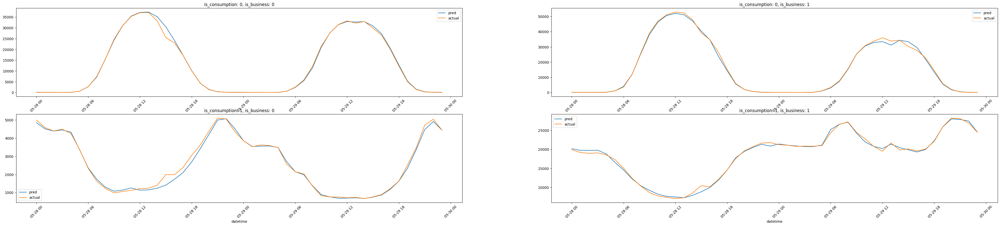

In [22]:
fig = plt.figure(figsize=(50, 10))

i = 0

list_is_consumption = [0, 1]
list_is_business = [0, 1]
    # "county": [0, 1],
    # "product_type": [0, 1],

for is_consumption in list_is_consumption:
    for is_business in list_is_business:
        ax = fig.add_subplot(2, 2, i+1)
        
        mask1 = (df_filtered_test["is_consumption"] == is_consumption) & (df_filtered_test["is_business"] == is_business)
        mask2 = (df_filtered_sample_prediction["is_consumption"] == is_consumption) & (df_filtered_sample_prediction["is_business"] == is_business)
        df_test_for_graph = df_filtered_test.filter(mask1).select(["datetime", "target"]).group_by("datetime").sum().sort("datetime")
        df_sample_prediction_for_graph = df_filtered_sample_prediction.filter(mask2).select(["datetime", "target"]).group_by("datetime").sum().sort("datetime")
        
        p1 = ax.plot(df_test_for_graph.select("datetime"), df_test_for_graph.select("target"), label="pred")
        p2 = ax.plot(df_sample_prediction_for_graph.select("datetime"), df_sample_prediction_for_graph.select("target"), label="actual")
        
        ax.set_xlabel("datetime")
        ax.set_title(f"is_consumption: {is_consumption}, is_business: {is_business}")
        labels = ax.get_xticklabels()
        plt.setp(labels, rotation=45, fontsize=10);
    
    
        # 凡例
        ax.legend()
    
        i += 1
plt.show()




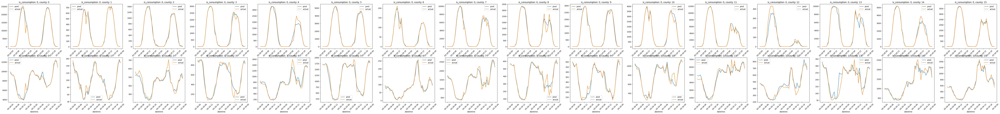

In [23]:
fig = plt.figure(figsize=(100, 10))

i = 0

list_is_consumption = [0, 1]
# list_is_business = [0, 1]
list_county = [i for i in range(0, 16)]
# product_type = [0, 1]

for is_consumption in list_is_consumption:
    for county in list_county:
        ax = fig.add_subplot(2, 16, i+1)
        
        mask1 = (df_filtered_test["is_consumption"] == is_consumption) & (df_filtered_test["county"] == county)
        mask2 = (df_filtered_sample_prediction["is_consumption"] == is_consumption) & (df_filtered_sample_prediction["county"] == county)
        df_test_for_graph = df_filtered_test.filter(mask1).select(["datetime", "target"]).group_by("datetime").sum().sort("datetime")
        df_sample_prediction_for_graph = df_filtered_sample_prediction.filter(mask2).select(["datetime", "target"]).group_by("datetime").sum().sort("datetime")
        
        p1 = ax.plot(df_test_for_graph.select("datetime"), df_test_for_graph.select("target"), label="pred")
        p2 = ax.plot(df_sample_prediction_for_graph.select("datetime"), df_sample_prediction_for_graph.select("target"), label="actual")
        
        ax.set_xlabel("datetime")
        ax.set_title(f"is_consumption: {is_consumption}, county: {county}")
        labels = ax.get_xticklabels()
        # plt.ylim(pl.concat([df_test_for_graph.select("target"), df_sample_prediction_for_graph.select("target")]).min()[0,0], pl.concat([df_test_for_graph.select("target"), df_sample_prediction_for_graph.select("target")]).max()[0,0])
        plt.setp(labels, rotation=45, fontsize=10);
    
    
        # 凡例
        ax.legend()
    
        i += 1
plt.show()


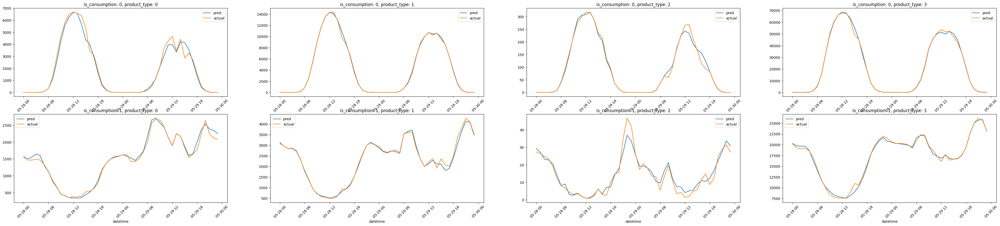

In [24]:
fig = plt.figure(figsize=(50, 10))

i = 0

list_is_consumption = [0, 1]
# list_is_business = [0, 1]
# list_county = [i for i in range(0, 16)]
list_product_type = [0, 1, 2, 3]

for is_consumption in list_is_consumption:
    for product_type in list_product_type:
        ax = fig.add_subplot(2, 4, i+1)
        
        mask1 = (df_filtered_test["is_consumption"] == is_consumption) & (df_filtered_test["product_type"] == product_type)
        mask2 = (df_filtered_sample_prediction["is_consumption"] == is_consumption) & (df_filtered_sample_prediction["product_type"] == product_type)
        df_test_for_graph = df_filtered_test.filter(mask1).select(["datetime", "target"]).group_by("datetime").sum().sort("datetime")
        df_sample_prediction_for_graph = df_filtered_sample_prediction.filter(mask2).select(["datetime", "target"]).group_by("datetime").sum().sort("datetime")
        
        p1 = ax.plot(df_test_for_graph.select("datetime"), df_test_for_graph.select("target"), label="pred")
        p2 = ax.plot(df_sample_prediction_for_graph.select("datetime"), df_sample_prediction_for_graph.select("target"), label="actual")
        
        ax.set_xlabel("datetime")
        ax.set_title(f"is_consumption: {is_consumption}, product_type: {product_type}")
        labels = ax.get_xticklabels()
        plt.setp(labels, rotation=45, fontsize=10);
    
    
        # 凡例
        ax.legend()
    
        i += 1
plt.show()


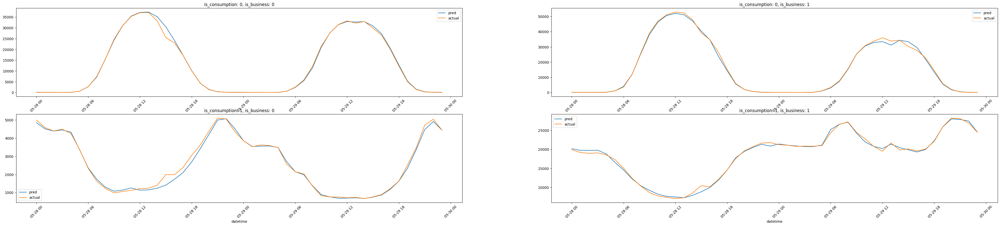

In [22]:
fig = plt.figure(figsize=(50, 10))

i = 0

list_is_consumption = [0, 1]
list_is_business = [0, 1]
    # "county": [0, 1],
    # "product_type": [0, 1],

for is_consumption in list_is_consumption:
    for is_business in list_is_business:
        ax = fig.add_subplot(2, 2, i+1)
        
        mask1 = (df_filtered_test["is_consumption"] == is_consumption) & (df_filtered_test["is_business"] == is_business)
        mask2 = (df_filtered_sample_prediction["is_consumption"] == is_consumption) & (df_filtered_sample_prediction["is_business"] == is_business)
        df_test_for_graph = df_filtered_test.filter(mask1).select(["datetime", "target"]).group_by("datetime").sum().sort("datetime")
        df_sample_prediction_for_graph = df_filtered_sample_prediction.filter(mask2).select(["datetime", "target"]).group_by("datetime").sum().sort("datetime")
        
        p1 = ax.plot(df_test_for_graph.select("datetime"), df_test_for_graph.select("target"), label="pred")
        p2 = ax.plot(df_sample_prediction_for_graph.select("datetime"), df_sample_prediction_for_graph.select("target"), label="actual")
        
        ax.set_xlabel("datetime")
        ax.set_title(f"is_consumption: {is_consumption}, is_business: {is_business}")
        labels = ax.get_xticklabels()
        plt.setp(labels, rotation=45, fontsize=10);
    
    
        # 凡例
        ax.legend()
    
        i += 1
plt.show()




## EDA

### train data

In [26]:
df_test

county,is_business,product_type,is_consumption,datetime,row_id,target
i64,i64,i64,i64,datetime[μs],i64,f64
0,0,1,0,2023-05-28 00:00:00,2005872,2.459245
0,0,1,1,2023-05-28 00:00:00,2005873,579.060821
0,0,2,0,2023-05-28 00:00:00,2005874,0.0
0,0,2,1,2023-05-28 00:00:00,2005875,4.311024
0,0,3,0,2023-05-28 00:00:00,2005876,15.93629
0,0,3,1,2023-05-28 00:00:00,2005877,1452.758421
0,1,0,0,2023-05-28 00:00:00,2005878,0.0
0,1,0,1,2023-05-28 00:00:00,2005879,458.731303
0,1,1,0,2023-05-28 00:00:00,2005880,0.0


In [33]:
i = 0
list_is_consumption = [0]
list_is_business = [0]
for is_consumption in list_is_consumption:
    for is_business in list_is_business:
        select_list = [
            "date",
            "target",
            "windspeed_10m_forecast",
            "windspeed_10m",
            "sin(winddirection_10m_forecast)",
            "cos(winddirection_10m_forecast)",
            "sin(winddirection_10m)",
            "cos(winddirection_10m)",
        ]

        fig = go.Figure()
        mask = (df_train_features["is_consumption"] == is_consumption) & (df_train_features["is_business"] == is_business)
        df_train_features_for_graph = df_train_features[mask][select_list]#.groupby("datetime").sum().sort("datetime")

        # fig.add_trace(go.Scatter(x=df_train_features_for_graph["date"], y=df_train_features_for_graph["windspeed_10m_forecast"], name="forecast"))
        # fig.add_trace(go.Scatter(x=df_train_features_for_graph["date"], y=df_train_features_for_graph["windspeed_10m"], name="actual"))
        # fig.add_trace(go.Scatter(x=df_train_features_for_graph["date"], y=df_train_features_for_graph["sin(winddirection_10m_forecast)"], name="forecast"))
        # fig.add_trace(go.Scatter(x=df_train_features_for_graph["date"], y=df_train_features_for_graph["sin(winddirection_10m)"], name="actual"))
        fig.add_trace(go.Scatter(x=df_train_features_for_graph["date"], y=df_train_features_for_graph["cos(winddirection_10m_forecast)"], name="forecast"))
        fig.add_trace(go.Scatter(x=df_train_features_for_graph["date"], y=df_train_features_for_graph["cos(winddirection_10m)"], name="actual"))
        
        fig.update_layout(title=f'is_consumption: {is_consumption}, is_business:{is_business}')
        i += 1
        fig.show()


KeyError: "['date'] not in index"

In [102]:
df_test_features = df_train_features
mask = (df_test_features["sin(month)"] == 0.5) & (df_test_features["cos(month)"] <= -0.866024) & (df_test_features["year"] == 2023) & (df_test_features["day"] >= 28)# & (df_test_features["is_consumption"] == 0)
df_test_features_filtered = df_test_features[mask]
df_test_features_filtered["target"] = r

In [58]:
df_test_features_filtered[df_test_features_filtered["formatted_installed_capacity"].isnull()][df_test_features["is_consumption"] == 0]["target"].describe()

count    3120.000000
mean      402.577529
std      1062.881770
min         0.000000
25%         1.320810
50%        51.953264
75%       291.938577
max      9968.556603
Name: target, dtype: float64

In [107]:
df_train_features[df_train_features["formatted_installed_capacity"].isnull()][df_train_features["is_consumption"] == 0]["target"].describe()

count     3120.000000
mean       401.237086
std       1072.605853
min          0.000000
25%          1.269500
50%         48.706000
75%        293.488500
max      11255.665000
Name: target, dtype: float64

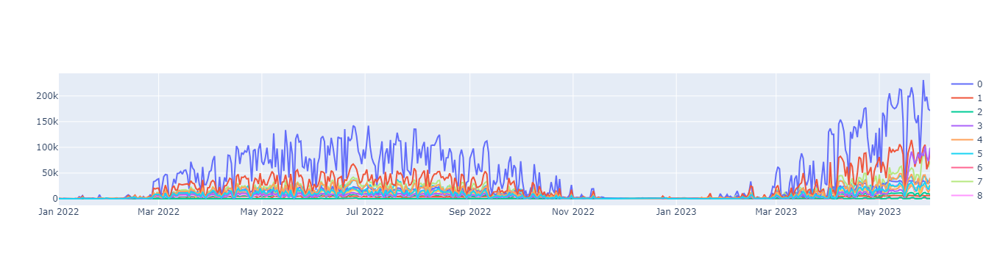

In [13]:
data = df_train_features
data["datetime"] = pd.to_datetime({'year': data['year'], 'month': data['month'], 'day': data['day']})
list_is_business = [0, 1]
list_is_consumption = [0, 1]
list_product_type = [0, 1, 2, 3]
list_county = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10 , 11, 12, 13, 14, 15]
fig = go.Figure()

target_col = "target"
for county in list_county:
    
    mask1 = (data["county"] == county) & (data["is_consumption"] == 0)
    data_for_graph = data[mask1][["datetime", target_col]].groupby("datetime").sum().sort_values("datetime").reset_index()
    # data_for_graph = data.filter(mask1).group_by("datetime").average().sort("datetime")


    # fig = px.histogram(data_for_graph, x='date',color='is_business')
    fig.add_trace(go.Scatter(x=data_for_graph["datetime"], y=data_for_graph[target_col], name=f"{county}"))
    # fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name="installed_capacity"))
    # fig.update_layout(title=f'county: {county}, is_business: {is_business}, product_type:{product_type}')
fig.show()


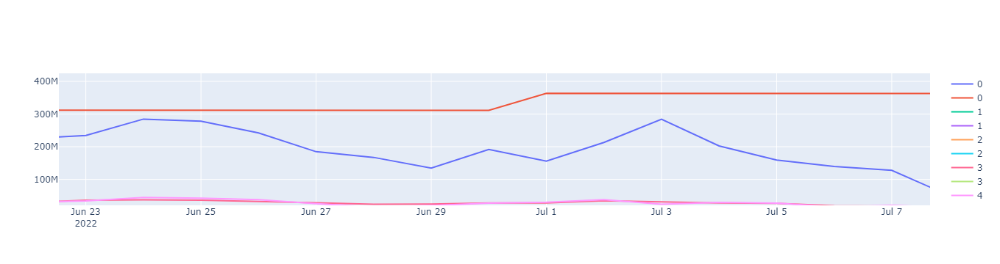

In [93]:
data = df_train_features
data["target"] = data["target"] * 2
data["datetime"] = pd.to_datetime({'year': data['year'], 'month': data['month'], 'day': data['day']})
list_is_business = [0, 1]
list_is_consumption = [0, 1]
list_product_type = [0, 1, 2, 3]
list_county = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10 , 11, 12, 13, 14, 15]
fig = go.Figure()

target_cols = ["target", "formatted_installed_capacity"]
for county in list_county:
    
    mask1 = (data["county"] == county) & (data["is_consumption"] == 0)
    data_for_graph = data[mask1][["datetime", *target_cols]].groupby("datetime").sum().sort_values("datetime").reset_index()
    # data_for_graph = data.filter(mask1).group_by("datetime").average().sort("datetime")


    # fig = px.histogram(data_for_graph, x='date',color='is_business')
    for target in target_cols:
        fig.add_trace(go.Scatter(x=data_for_graph["datetime"], y=data_for_graph[target], name=f"{county}"))
    # fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name="installed_capacity"))
    # fig.update_layout(title=f'county: {county}, is_business: {is_business}, product_type:{product_type}')
fig.show()


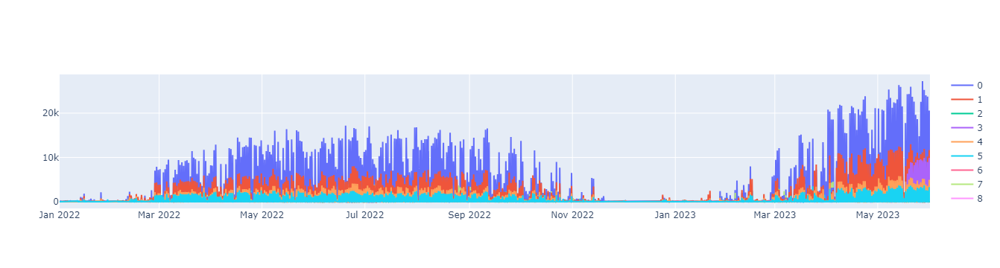

In [60]:
data = data_storage.df_data

list_is_business = [0, 1]
list_is_consumption = [0, 1]
list_product_type = [0, 1, 2, 3]
list_county = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10 , 11, 12, 13, 14, 15]
fig = go.Figure()
for county in list_county:
    
    mask1 = (data["county"] == county) & (data["is_consumption"] == 0)
    data_for_graph = data.filter(mask1).select(["datetime", "target"]).group_by("datetime").sum().sort("datetime")
    # data_for_graph = data.filter(mask1).group_by("datetime").average().sort("datetime")


    # fig = px.histogram(data_for_graph, x='date',color='is_business')
    fig.add_trace(go.Scatter(x=data_for_graph.select("datetime").to_series(), y=data_for_graph.select("target").to_series(), name=f"{county}"))
    # fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name="installed_capacity"))
    # fig.update_layout(title=f'county: {county}, is_business: {is_business}, product_type:{product_type}')
fig.show()


### client

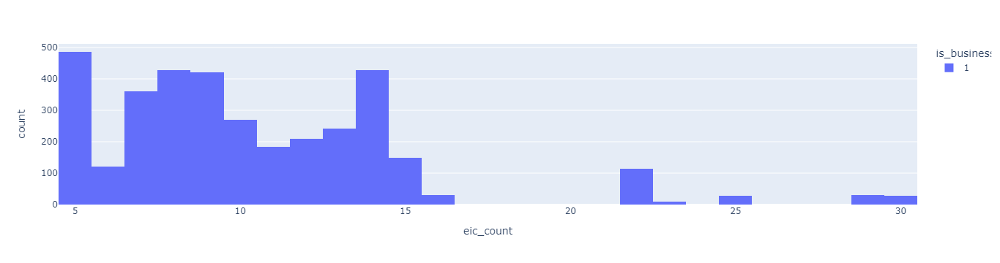

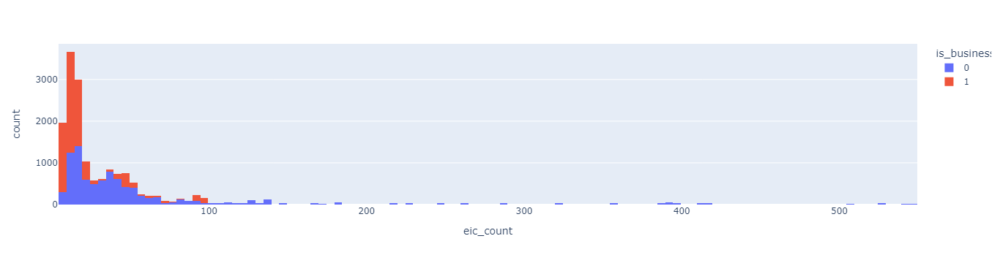

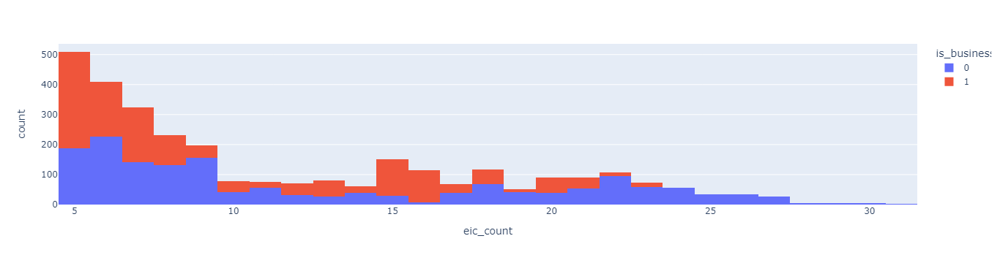

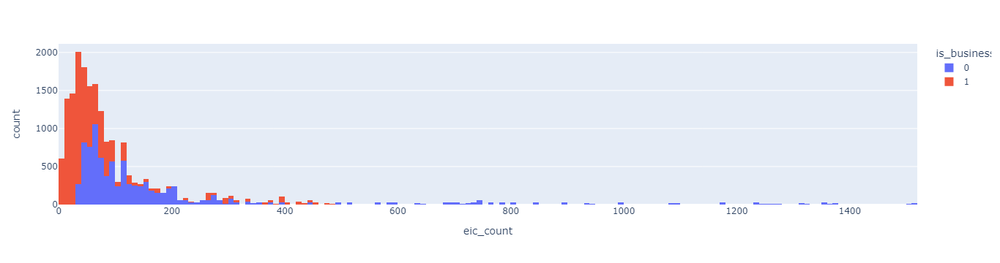

In [109]:
data = data_storage.df_client

list_is_business = [0, 1]
list_product_type = [0, 1, 2, 3]
for product_type in list_product_type:

    # fig = go.Figure()
    mask1 = data["product_type"] == product_type
    data_for_graph = data.filter(mask1) # .group_by("datetime").average().sort("datetime")
    # data_for_graph = data.filter(mask1).group_by("datetime").average().sort("datetime")

    fig = px.histogram(data_for_graph, x='eic_count',color='is_business')
    # fig.add_trace(go.Scatter(x=data_for_graph.select("datetime").to_series(), y=data_for_graph.select("eic_count").to_series(), name="eic_count"))
    # fig.add_trace(go.Scatter(x=data_for_graph.select("datetime").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name="installed_capacity"))
    # fig.update_layout(title=f'is_business: {is_business}, product_type:{product_type}')
    fig.show()


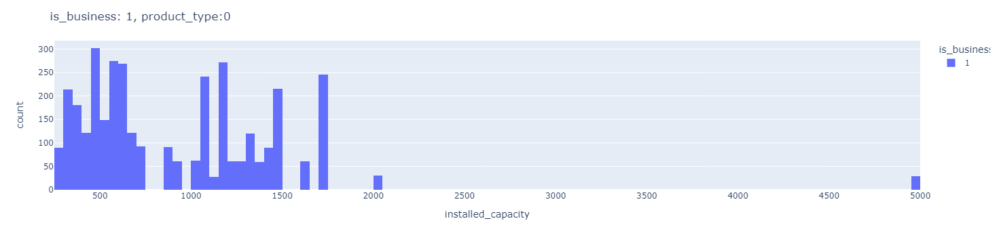

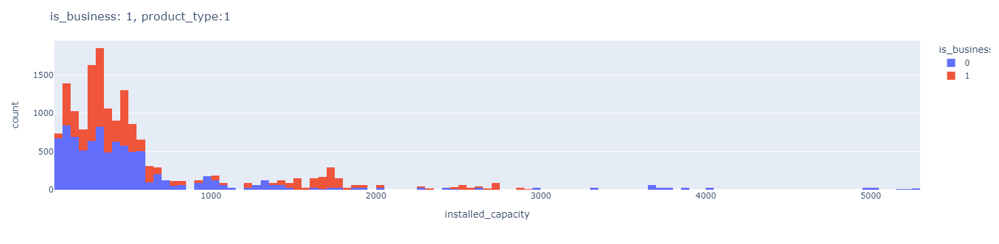

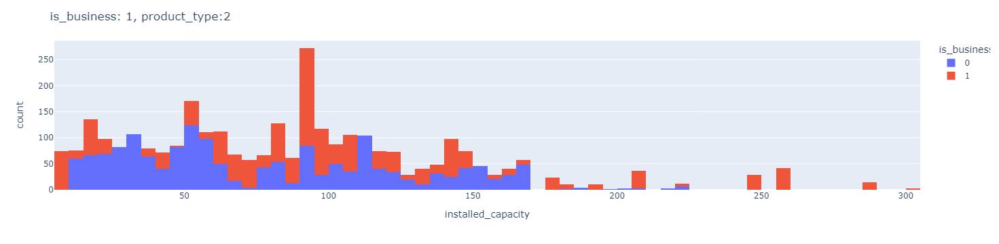

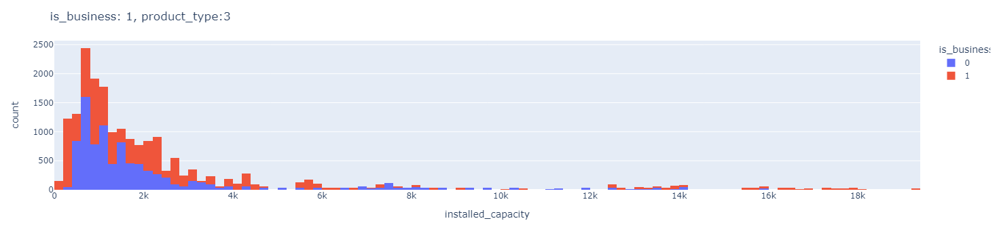

In [21]:
data = data_storage.df_client

list_is_business = [0, 1]
list_product_type = [0, 1, 2, 3]
for product_type in list_product_type:

    # fig = go.Figure()
    mask1 = data["product_type"] == product_type
    data_for_graph = data.filter(mask1) # .group_by("datetime").average().sort("datetime")
    # data_for_graph = data.filter(mask1).group_by("datetime").average().sort("datetime")

    fig = px.histogram(data_for_graph, x='installed_capacity',color='is_business')
    # fig.add_trace(go.Scatter(x=data_for_graph.select("datetime").to_series(), y=data_for_graph.select("eic_count").to_series(), name="eic_count"))
    # fig.add_trace(go.Scatter(x=data_for_graph.select("datetime").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name="installed_capacity"))
    fig.update_layout(title=f'is_business: {is_business}, product_type:{product_type}')
    fig.show()


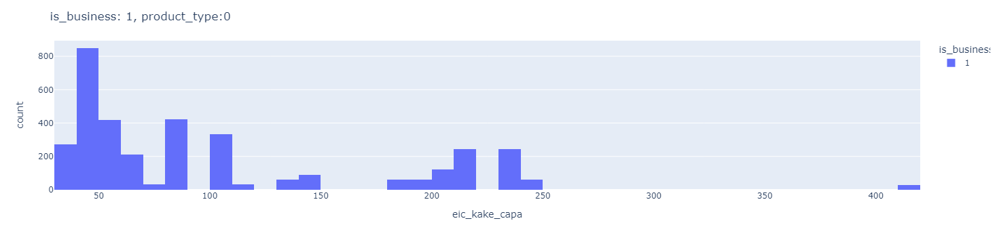

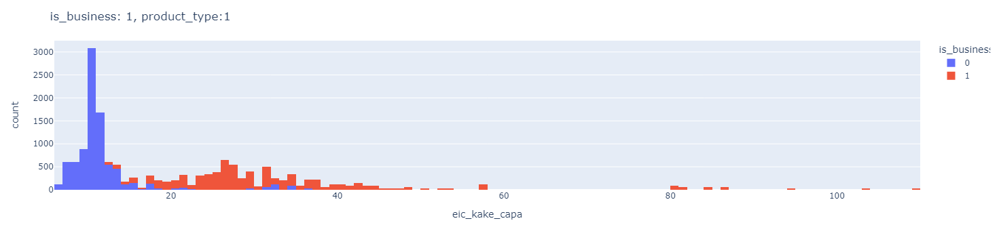

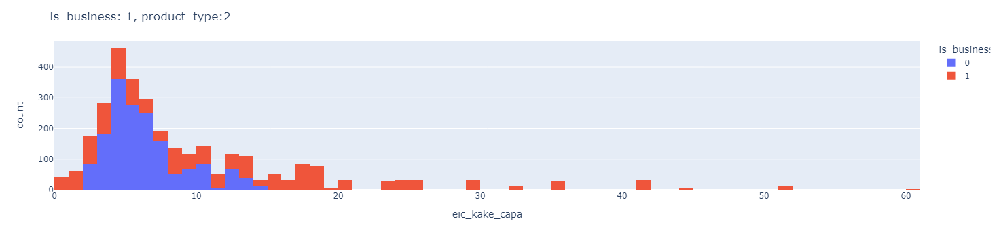

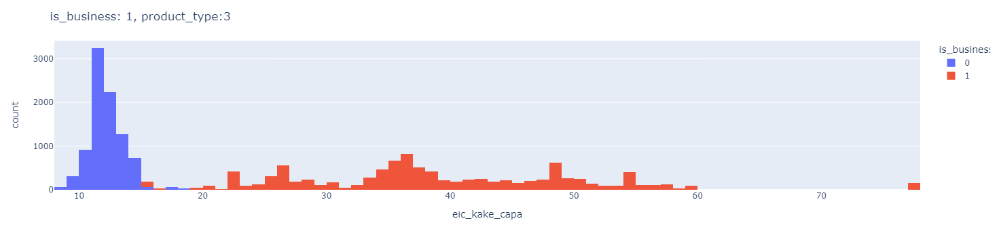

In [25]:
data = data_storage.df_client

list_is_business = [0, 1]
list_product_type = [0, 1, 2, 3]
for product_type in list_product_type:

    # fig = go.Figure()
    mask1 = data["product_type"] == product_type
    data_for_graph = data.filter(mask1) # .group_by("datetime").average().sort("datetime")
    # data_for_graph = data.filter(mask1).group_by("datetime").average().sort("datetime")

    data_for_graph = data_for_graph.with_columns(
        (pl.col("installed_capacity") / pl.col("eic_count"))
        .alias("eic_kake_capa")
    )

    fig = px.histogram(data_for_graph, x='eic_kake_capa',color='is_business')
    # fig.add_trace(go.Scatter(x=data_for_graph.select("datetime").to_series(), y=data_for_graph.select("eic_count").to_series(), name="eic_count"))
    # fig.add_trace(go.Scatter(x=data_for_graph.select("datetime").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name="installed_capacity"))
    fig.update_layout(title=f'is_business: {is_business}, product_type:{product_type}')
    fig.show()


In [110]:
data_storage.df_client

product_type,county,eic_count,installed_capacity,is_business,date
i64,i64,i64,f64,i64,date
1,0,108,952.89,0,2021-09-01
2,0,17,166.4,0,2021-09-01
3,0,688,7207.88,0,2021-09-01
0,0,5,400.0,1,2021-09-01
1,0,43,1411.0,1,2021-09-01
3,0,265,13417.79,1,2021-09-01
1,1,7,80.0,0,2021-09-01
3,1,42,472.6,0,2021-09-01
3,1,12,295.5,1,2021-09-01


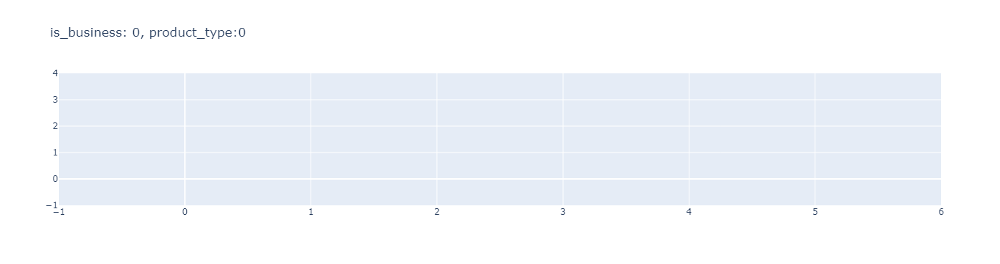

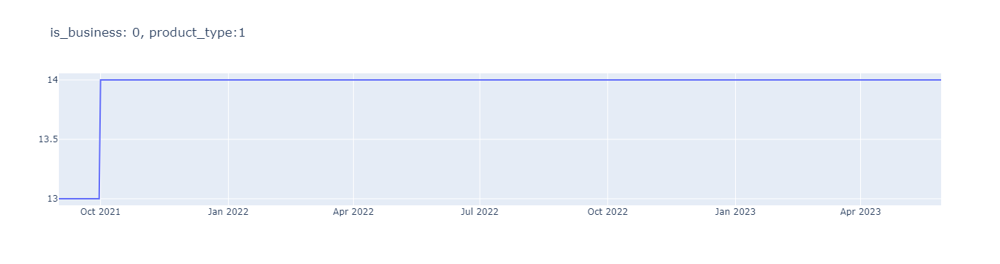

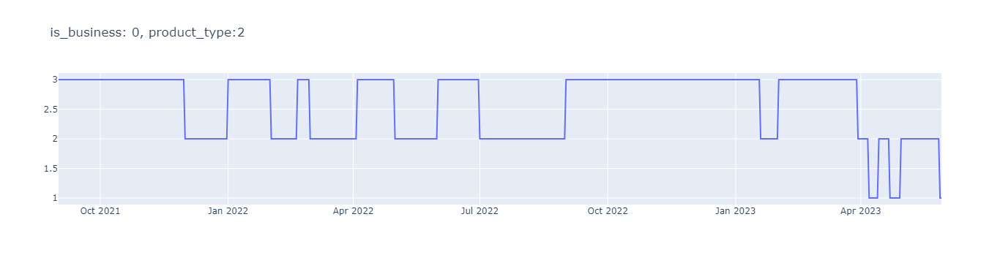

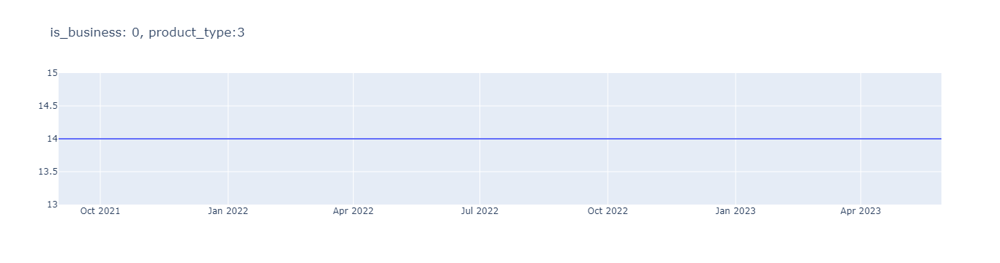

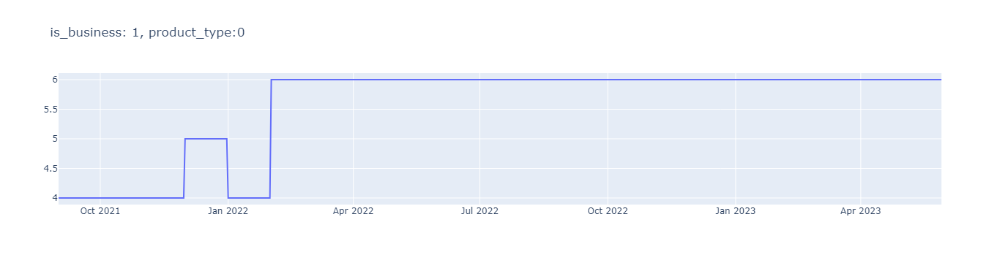

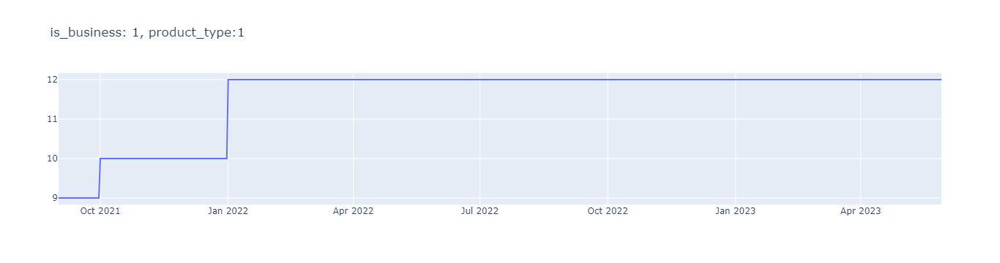

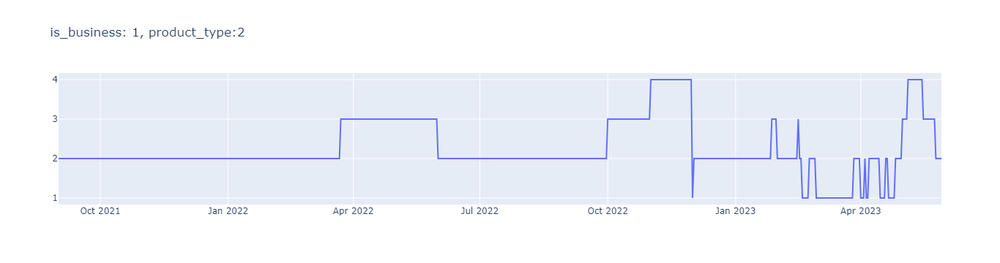

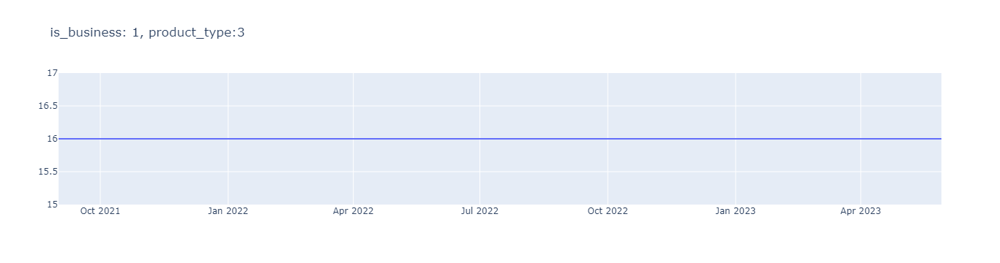

In [112]:
data = data_storage.df_client

list_is_business = [0, 1]
list_product_type = [0, 1, 2, 3]
county = 0
for is_business in list_is_business:
    for product_type in list_product_type:

        fig = go.Figure()
        mask1 = (data["is_business"] == is_business) & (data["product_type"] == product_type)# & (data["county"] == county)
        data_for_graph = data.filter(mask1).select(["date", "installed_capacity"]).group_by("date").count().sort("date")
        # data_for_graph = data.filter(mask1).group_by("datetime").average().sort("datetime")
    
    
        # fig = px.histogram(data_for_graph, x='date',color='is_business')
        fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("count").to_series(), name="count"))
        # fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name="installed_capacity"))
        fig.update_layout(title=f'is_business: {is_business}, product_type:{product_type}')
        fig.show()


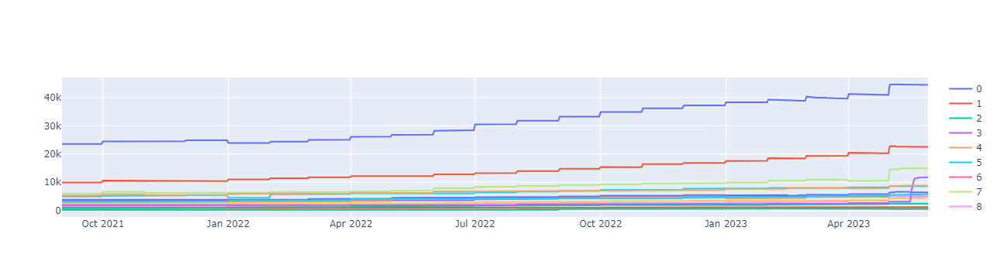

In [52]:
data = data_storage.df_client

list_is_business = [0, 1]
list_product_type = [0, 1, 2, 3]
list_county = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10 , 11, 12, 13, 14, 15]
fig = go.Figure()
for county in list_county:
    
    mask1 = data["county"] == county
    data_for_graph = data.filter(mask1).select(["date", "installed_capacity"]).group_by("date").sum().sort("date")
    # data_for_graph = data.filter(mask1).group_by("datetime").average().sort("datetime")


    # fig = px.histogram(data_for_graph, x='date',color='is_business')
    fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name=f"{county}"))
    # fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name="installed_capacity"))
    # fig.update_layout(title=f'county: {county}, is_business: {is_business}, product_type:{product_type}')
fig.show()


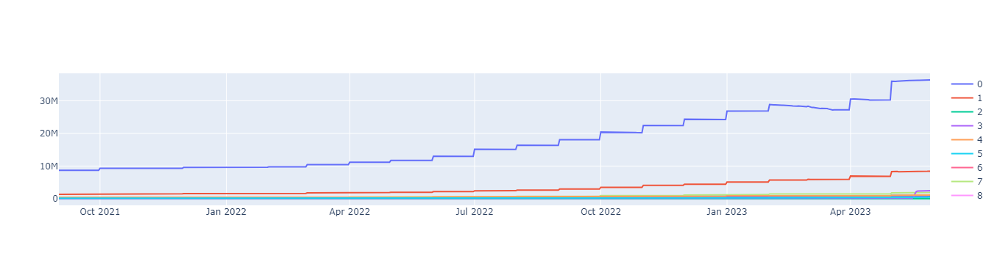

In [61]:
data = data_storage.df_client

list_is_business = [0, 1]
list_product_type = [0, 1, 2, 3]
list_county = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10 , 11, 12, 13, 14, 15]
fig = go.Figure()
for county in list_county:
    
    mask1 = data["county"] == county
    data = data.with_columns(
        (pl.col("installed_capacity") * pl.col("eic_count"))
        .alias("eic_kake_capa")
    )
    data_for_graph = data.filter(mask1).select(["date", "eic_kake_capa"]).group_by("date").sum().sort("date")
    # data_for_graph = data.filter(mask1).group_by("datetime").average().sort("datetime")


    # fig = px.histogram(data_for_graph, x='date',color='is_business')
    fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("eic_kake_capa").to_series(), name=f"{county}"))
    # fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name="installed_capacity"))
    # fig.update_layout(title=f'county: {county}, is_business: {is_business}, product_type:{product_type}')
fig.show()


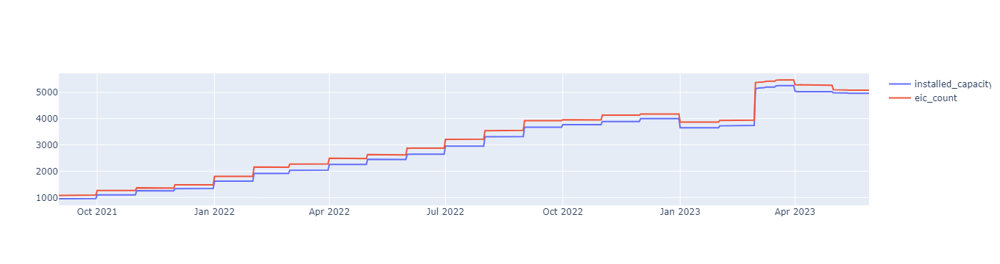

In [119]:
data = data_storage.df_client

list_is_business = [0, 1]
list_product_type = [0, 1, 2, 3]
list_county = [0]#, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10 , 11, 12, 13, 14, 15]
fig = go.Figure()
for county in list_county:
    
    mask1 = (data["county"] == county) & (data["product_type"] == 1) & (data["is_business"] == 0)
    data = data.with_columns(
        (pl.col("installed_capacity") * pl.col("eic_count"))
        .alias("eic_kake_capa")
    )
    data_for_graph = data.filter(mask1).select(["date", "installed_capacity", "eic_count"]).sort("date")
    # data_for_graph = data.filter(mask1).group_by("datetime").average().sort("datetime")


    # fig = px.histogram(data_for_graph, x='date',color='is_business')
    fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name=f"installed_capacity"))
    fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("eic_count").to_series()*10, name=f"eic_count"))
    # fig.add_trace(go.Scatter(x=data_for_graph.select("date").to_series(), y=data_for_graph.select("installed_capacity").to_series(), name="installed_capacity"))
    # fig.update_layout(title=f'county: {county}, is_business: {is_business}, product_type:{product_type}')
fig.show()


## 精度検証

### 相関

In [14]:
df_train_consumption = df_train_features[df_train_features["is_consumption"]==1]
df_train_production = df_train_features[df_train_features["is_consumption"]==0]

In [15]:
corr = pd.concat([df_train_consumption["target"], df_train_consumption.drop("target",axis=1)],axis=1).corr()
corr_pro = pd.concat([df_train_production["target"], df_train_production.drop("target",axis=1)],axis=1).corr()

,target,county,is_business,product_type,is_consumption,day,weekday,month,year,segment,sin(dayofyear),cos(dayofyear),sin(hour),cos(hour),temperature,dewpoint,cloudcover_high,cloudcover_low,cloudcover_mid,cloudcover_total,10_metre_u_wind_component,10_metre_v_wind_component,direct_solar_radiation,surface_solar_radiation_downwards,snowfall,total_precipitation,windspeed_10m_forecast,sin(winddirection_10m_forecast),cos(winddirection_10m_forecast),temperature_forecast_local_0h,dewpoint_forecast_local_0h,cloudcover_high_forecast_local_0h,cloudcover_low_forecast_local_0h,cloudcover_mid_forecast_local_0h,cloudcover_total_forecast_local_0h,10_metre_u_wind_component_forecast_local_0h,10_metre_v_wind_component_forecast_local_0h,direct_solar_radiation_forecast_local_0h,surface_solar_radiation_downwards_forecast_local_0h,snowfall_forecast_local_0h,total_precipitation_forecast_local_0h,windspeed_10m_forecast_forecast_local_0h,sin(winddirection_10m_forecast)_forecast_local_0h,cos(winddirection_10m_forecast)_forecast_local_0h,temperature_forecast_168h,dewpoint_forecast_168h,cloudcover_high_forecast_168h,cloudcover_low_forecast_168h,cloudcover_mid_forecast_168h,cloudcover_total_forecast_168h,...,cloudcover_total_historical_24h,cloudcover_low_historical_24h,cloudcover_mid_historical_24h,cloudcover_high_historical_24h,windspeed_10m_historical_24h,winddirection_10m_historical_24h,shortwave_radiation_historical_24h,direct_solar_radiation_historical_24h,diffuse_radiation_historical_24h,sin(winddirection_10m)_historical_24h,cos(winddirection_10m)_historical_24h,target_48h,target_72h,target_96h,target_120h,target_144h,target_168h,target_192h,target_216h,target_240h,target_264h,target_288h,target_312h,target_336h,target_all_type_sum_48h,target_all_county_type_sum_48h,target_all_type_sum_72h,target_all_county_type_sum_72h,target_all_type_sum_168h,target_all_county_type_sum_168h,target_all_type_sum_336h,target_all_county_type_sum_336h,target_ratio_168_336,target_ratio_48_216,target_ratio_72_240,target_ratio_48_72,target_all_type_sum_ratio_48_72,target_all_type_sum_ratio_168_336,target_all_county_type_sum_ratio_48_72,target_all_county_type_sum_ratio_168_336,is_country_holiday,log_target_mean,log_target_std,temperature_diff_1,dewpoint_diff_1,10_metre_u_wind_component_diff_1,10_metre_v_wind_component_diff_1,windspeed_diff_act_forecast,winddirsin_diff_act_forecast,winddircos_diff_act_forecast
target,1.000000,-0.135825,0.248443,0.222618,NaN,-0.008708,-0.038598,-0.016997,0.038842,-0.132691,0.005500,0.082407,-4.451785e-03,-1.370207e-02,-0.074903,-0.063392,0.021052,0.068441,0.038130,0.054543,-0.009315,0.013092,-0.059569,-0.059660,0.033291,0.014904,0.029072,0.012897,-0.014565,-0.079289,-0.062762,0.018318,0.062163,0.031681,0.047423,-0.015132,0.020167,-0.058808,-0.060443,0.026101,0.007949,0.021804,0.020909,-0.018583,-0.063898,-0.053095,0.017340,0.060481,0.027196,0.045497,...,0.046374,0.051255,0.028575,0.013798,0.022649,0.003970,-0.033339,-0.034279,-0.026867,0.002697,-0.011978,0.945146,0.938314,0.936925,0.941304,0.962506,0.980054,0.960847,0.938244,0.932047,0.931522,0.936135,0.958255,0.976663,0.511275,0.256363,0.506976,0.252052,0.534587,0.283284,0.532953,0.281732,-0.000403,-0.000633,-0.000560,-0.000426,0.005855,0.004664,0.001398,0.000473,-0.049229,0.575036,0.542119,-0.008290,0.004025,-0.002012,0.004915,0.005272,0.004109,-0.000507
county,-0.135825,1.000000,0.026709,0.004480,NaN,0.000090,-0.000235,0.003693,-0.002175,0.999946,-0.002175,-0.001286,2.387018e-07,2.387018e-07,0.001409,0.001046,-0.000484,-0.000169,-0.000739,-0.000366,-0.000564,-0.000011,0.000497,0.000542,-0.001197,-0.000689,-0.000900,-0.000108,-0.000556,0.010039,0.004007,-0.001844,0.009129,0.010883,0.009335,0.016773,-0.003361,-0.010533,-0.001352,-0.009726,0.003438,-0.000387,-0.003629,0.009356,0.001912,0.001736,-0.000825,-0.000613,-0.001321,-0.000894,...,-0.000521,-0.000157,-0.000866,-0.000271,-0.000860,0.000344,0.000739,0.000826,0.000457,0.000069,-0.000574,-0.135744,-0.135743,-0.135671,-0.135628,-0.135636,-0.1

In [28]:
for i, y_corr in zip(corr.index,corr["target"]):
    print(i, y_corr, sep=",")

target,1.0
county,-0.13582456407909393
is_business,0.2484425735768543
product_type,0.222617931220522
is_consumption,nan
day,-0.008708144663167834
weekday,-0.0385978711005951
month,-0.01699721038502432
year,0.03884192726850447
segment,-0.13269141639678872
sin(dayofyear),0.005499745482789378
cos(dayofyear),0.08240676567595512
sin(hour),-0.004451784857327905
cos(hour),-0.013702072143831736
temperature,-0.07490290685849933
dewpoint,-0.06339230945438017
cloudcover_high,0.021051508374690255
cloudcover_low,0.06844127884036273
cloudcover_mid,0.03813021328728013
cloudcover_total,0.05454271776698146
10_metre_u_wind_component,-0.009315300369597752
10_metre_v_wind_component,0.013091785627303672
direct_solar_radiation,-0.059569063433419826
surface_solar_radiation_downwards,-0.059660366462804364
snowfall,0.033290740194508915
total_precipitation,0.014904408677815527
windspeed_10m_forecast,0.029072120075987244
sin(winddirection_10m_forecast),0.012896763793162966
cos(winddirection_10m_forecast),-0.0145

In [29]:
for i, y_corr in zip(corr_pro.index,corr["target"]):
    print(i, y_corr, sep=",")

target,1.0
county,-0.13582456407909393
is_business,0.2484425735768543
product_type,0.222617931220522
is_consumption,nan
day,-0.008708144663167834
weekday,-0.0385978711005951
month,-0.01699721038502432
year,0.03884192726850447
segment,-0.13269141639678872
sin(dayofyear),0.005499745482789378
cos(dayofyear),0.08240676567595512
sin(hour),-0.004451784857327905
cos(hour),-0.013702072143831736
temperature,-0.07490290685849933
dewpoint,-0.06339230945438017
cloudcover_high,0.021051508374690255
cloudcover_low,0.06844127884036273
cloudcover_mid,0.03813021328728013
cloudcover_total,0.05454271776698146
10_metre_u_wind_component,-0.009315300369597752
10_metre_v_wind_component,0.013091785627303672
direct_solar_radiation,-0.059569063433419826
surface_solar_radiation_downwards,-0.059660366462804364
snowfall,0.033290740194508915
total_precipitation,0.014904408677815527
windspeed_10m_forecast,0.029072120075987244
sin(winddirection_10m_forecast),0.012896763793162966
cos(winddirection_10m_forecast),-0.0145

### cross validation

In [12]:
%%time

# 2回目でのエラーの回避のため、nnはスキップ（ValueError: Unable to synchronously create dataset (name already exists)）
CFG.nn = False

#KFoldの設定
kf = KFold(n_splits = 5, shuffle = True, random_state = 1)

con_df, pro_df = devide_cp(df_train_features)

list_mae_score_consumption = []
list_mae_score_production = []

#交差検証
for tr_idx, va_idx in kf.split(con_df):
    train_df = pd.concat([con_df.iloc[tr_idx], pro_df.iloc[tr_idx]], axis=0)
    val_df = pd.concat([con_df.iloc[va_idx], pro_df.iloc[va_idx]], axis=0)
    train_x, train_y = train_df.drop("target",axis=1), train_df["target"]
    val_x, val_y = val_df.drop("target",axis=1), val_df["target"]

    model = Model(1)
    model.fit(train_df)
    pred = model.predict(val_x)
    val_x["target"] = pred

    cons_pred, pro_pred = devide_cp(val_x)
    cons_actual, pro_actual = devide_cp(val_df)
    
    mae_score_consumption = sklearn.metrics.mean_absolute_error(cons_pred["target"], cons_actual["target"])
    mae_score_production = sklearn.metrics.mean_absolute_error(pro_pred["target"], pro_actual["target"])
    
    print(f"mae_score_consumption: {mae_score_consumption}")
    print(f"mae_score_production: {mae_score_production}")

    list_mae_score_consumption.append(mae_score_consumption)
    list_mae_score_production.append(mae_score_production)

CFG.nn = True

print(f"consumption's average mae score: {np.mean(list_mae_score_consumption)}")
print(f"production's average mae score: {np.mean(list_mae_score_production)}")

nn = False
lgb = True

 lgb model consumption training.

 lgb model production training. 


 lgb model consumption prediction. 


 lgb model production prediction. 

mae_score_consumption: 30.373591923277907
mae_score_production: 15.63632528736185
nn = False
lgb = True

 lgb model consumption training.

 lgb model production training. 


 lgb model consumption prediction. 


 lgb model production prediction. 

mae_score_consumption: 30.654328574517834
mae_score_production: 15.890602810038775
nn = False
lgb = True

 lgb model consumption training.

 lgb model production training. 


 lgb model consumption prediction. 


 lgb model production prediction. 

mae_score_consumption: 30.87285296421468
mae_score_production: 16.087990664541692
nn = False
lgb = True

 lgb model consumption training.

 lgb model production training. 


 lgb model consumption prediction. 


 lgb model production prediction. 

mae_score_consumption: 30.881690793103406
mae_score_production: 16.045828828560303
nn = F

In [13]:
now = datetime.datetime.now()

mae_filepath = os.path.join(const.WORK_DIR, f"cross_validation_result/mae_score_{now.strftime('%Y%m%d%H%M%S')}.txt")

with open(mae_filepath, 'w') as f:
    for i in range(len(list_mae_score_consumption)):
        mae_score_consumption = list_mae_score_consumption[i]
        mae_score_production = list_mae_score_production[i]
        
        f.write(f"i: {i}\n")
        f.write(f"mae_score_consumption: {mae_score_consumption}\n")
        f.write(f"mae_score_production: {mae_score_production}\n")
        print(f"i: {i}")
        print(f"mae_score_consumption: {mae_score_consumption}")
        print(f"mae_score_production: {mae_score_production}")

    print("")
    print(f"consumption's average mae score: {np.mean(list_mae_score_consumption)}")
    print(f"production's average mae score: {np.mean(list_mae_score_production)}")
    f.write("\n")
    f.write(f"consumption's average mae score: : {np.mean(list_mae_score_consumption)}\n")
    f.write(f"production's average mae score: {np.mean(list_mae_score_production)}\n")
    

i: 0
mae_score_consumption: 30.373591923277907
mae_score_production: 15.63632528736185
i: 1
mae_score_consumption: 30.654328574517834
mae_score_production: 15.890602810038775
i: 2
mae_score_consumption: 30.87285296421468
mae_score_production: 16.087990664541692
i: 3
mae_score_consumption: 30.881690793103406
mae_score_production: 16.045828828560303
i: 4
mae_score_consumption: 31.137231363003735
mae_score_production: 15.476951136709157


## 99-3.パラメータチューニング

In [14]:
df_train_features[(df_train_features["year"]==2022)&(df_train_features["is_consumption"]==0)]

,county,is_business,product_type,is_consumption,day,weekday,month,year,segment,sin(dayofyear),cos(dayofyear),sin(hour),cos(hour),temperature,dewpoint,cloudcover_high,cloudcover_low,cloudcover_mid,cloudcover_total,10_metre_u_wind_component,10_metre_v_wind_component,direct_solar_radiation,surface_solar_radiation_downwards,snowfall,total_precipitation,windspeed_10m_forecast,sin(winddirection_10m_forecast),cos(winddirection_10m_forecast),temperature_forecast_local_0h,dewpoint_forecast_local_0h,cloudcover_high_forecast_local_0h,cloudcover_low_forecast_local_0h,cloudcover_mid_forecast_local_0h,cloudcover_total_forecast_local_0h,10_metre_u_wind_component_forecast_local_0h,10_metre_v_wind_component_forecast_local_0h,direct_solar_radiation_forecast_local_0h,surface_solar_radiation_downwards_forecast_local_0h,snowfall_forecast_local_0h,total_precipitation_forecast_local_0h,windspeed_10m_forecast_forecast_local_0h,sin(winddirection_10m_forecast)_forecast_local_0h,cos(winddirection_10m_forecast)_forecast_local_0h,temperature_forecast_168h,dewpoint_forecast_168h,cloudcover_high_forecast_168h,cloudcover_low_forecast_168h,cloudcover_mid_forecast_168h,cloudcover_total_forecast_168h,10_metre_u_wind_component_forecast_168h,...,cloudcover_low_historical_24h,cloudcover_mid_historical_24h,cloudcover_high_historical_24h,windspeed_10m_historical_24h,winddirection_10m_historical_24h,shortwave_radiation_historical_24h,direct_solar_radiation_historical_24h,diffuse_radiation_historical_24h,sin(winddirection_10m)_historical_24h,cos(winddirection_10m)_historical_24h,target_48h,target_72h,target_96h,target_120h,target_144h,target_168h,target_192h,target_216h,target_240h,target_264h,target_288h,target_312h,target_336h,target_all_type_sum_48h,target_all_county_type_sum_48h,target_all_type_sum_72h,target_all_county_type_sum_72h,target_all_type_sum_168h,target_all_county_type_sum_168h,target_all_type_sum_336h,target_all_county_type_sum_336h,target_ratio_168_336,target_ratio_48_216,target_ratio_72_240,target_ratio_48_72,target_all_type_sum_ratio_48_72,target_all_type_sum_ratio_168_336,target_all_county_type_sum_ratio_48_72,target_all_county_type_sum_ratio_168_336,is_country_holiday,log_target_mean,log_target_std,target,temperature_diff_1,dewpoint_diff_1,10_metre_u_wind_component_diff_1,10_metre_v_wind_component_diff_1,windspeed_diff_act_forecast,winddirsin_diff_act_forecast,winddircos_diff_act_forecast
row_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
366048,0,0,1,0,1,6,1,2022,0_0_1_0,0.017166,0.999853,0.000000,1.000000,-0.246805,-0.777223,0.367615,0.930420,0.591207,0.995787,0.617221,-0.222493,0.0,0.0,1.603205e-05,0.000065,2.240640,0.031109,0.234394,-4.124589,-4.592993,0.749156,0.923236,0.957959,0.999995,0.002135,0.237211,0.0,0.0,8.940697e-07,7.763738e-07,0.955599,0.499630,-0.095525,-7.310143,-10.651634,0.003465,0.534964,0.304186,0.719171,3.110685,...,96.553574,76.79464,72.73214,6.972718,203.258926,9.321428,6.375,2.946429,0.360652,0.86313,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,0.000000,0.000000,0.000,NaN,NaN,NaN,NaN,-2.348149,0.050231,-0.750018
366050,0,0,2,0,1,6,1,2022,0_0_2_0,0.017166,0.999853,0.000000,1.000000,-0.246805,-0.777223,0.367615,0.930420,0.591207,0.995787,0.617221,-0.222493,0.0,0.0,1.603205e-05,0.000065,2.240640,0.031109,0.234394,-4.124589,-4.592993,0.749156,0.923236,0.957959,0.999995,0.002135,0.237211,0.0,0.0,8.940697e-07,7.763738e-07,0.955599,0.499630,-0.095525,-7.310143,-10.651634,0.003465,0.534964,0.304186,0.719171,3.110685,...,96.553574,76.79464,72.73214,6.972718,203.258926,9.321428,6.375,2.946429,0.360652,0.86313,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,0.000000,0.000000,0.000,NaN,NaN,NaN,NaN,-2.348149,0.050231,-0.750018
366052,0,0,3,0,1,6,1,2022,0_0_3_0,0.017166,0.999853,0.000000,1.000000,-0.246805,-0.777223,0.367615,0.930420

In [15]:
df_train_features[df_train_features["year"]==2023]

,county,is_business,product_type,is_consumption,day,weekday,month,year,segment,sin(dayofyear),cos(dayofyear),sin(hour),cos(hour),temperature,dewpoint,cloudcover_high,cloudcover_low,cloudcover_mid,cloudcover_total,10_metre_u_wind_component,10_metre_v_wind_component,direct_solar_radiation,surface_solar_radiation_downwards,snowfall,total_precipitation,windspeed_10m_forecast,sin(winddirection_10m_forecast),cos(winddirection_10m_forecast),temperature_forecast_local_0h,dewpoint_forecast_local_0h,cloudcover_high_forecast_local_0h,cloudcover_low_forecast_local_0h,cloudcover_mid_forecast_local_0h,cloudcover_total_forecast_local_0h,10_metre_u_wind_component_forecast_local_0h,10_metre_v_wind_component_forecast_local_0h,direct_solar_radiation_forecast_local_0h,surface_solar_radiation_downwards_forecast_local_0h,snowfall_forecast_local_0h,total_precipitation_forecast_local_0h,windspeed_10m_forecast_forecast_local_0h,sin(winddirection_10m_forecast)_forecast_local_0h,cos(winddirection_10m_forecast)_forecast_local_0h,temperature_forecast_168h,dewpoint_forecast_168h,cloudcover_high_forecast_168h,cloudcover_low_forecast_168h,cloudcover_mid_forecast_168h,cloudcover_total_forecast_168h,10_metre_u_wind_component_forecast_168h,...,cloudcover_low_historical_24h,cloudcover_mid_historical_24h,cloudcover_high_historical_24h,windspeed_10m_historical_24h,winddirection_10m_historical_24h,shortwave_radiation_historical_24h,direct_solar_radiation_historical_24h,diffuse_radiation_historical_24h,sin(winddirection_10m)_historical_24h,cos(winddirection_10m)_historical_24h,target_48h,target_72h,target_96h,target_120h,target_144h,target_168h,target_192h,target_216h,target_240h,target_264h,target_288h,target_312h,target_336h,target_all_type_sum_48h,target_all_county_type_sum_48h,target_all_type_sum_72h,target_all_county_type_sum_72h,target_all_type_sum_168h,target_all_county_type_sum_168h,target_all_type_sum_336h,target_all_county_type_sum_336h,target_ratio_168_336,target_ratio_48_216,target_ratio_72_240,target_ratio_48_72,target_all_type_sum_ratio_48_72,target_all_type_sum_ratio_168_336,target_all_county_type_sum_ratio_48_72,target_all_county_type_sum_ratio_168_336,is_country_holiday,log_target_mean,log_target_std,target,temperature_diff_1,dewpoint_diff_1,10_metre_u_wind_component_diff_1,10_metre_v_wind_component_diff_1,windspeed_diff_act_forecast,winddirsin_diff_act_forecast,winddircos_diff_act_forecast
row_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1537584,0,0,1,0,1,7,1,2023,0_0_1_0,0.017166,0.999853,0.000000,1.000000,5.092503,4.157948,0.938069,0.741888,0.844411,0.991078,5.298185,4.087361,0.000000,0.0,0.0,0.000111,6.986148,0.623219,0.731564,5.164300,4.600814,0.774271,0.756655,0.980081,0.996560,4.360873,3.215323,0.000000,0.0,0.0,0.000236,5.464893,0.599019,0.790200,-2.870615,-4.897900,0.418334,0.334964,0.001703,0.658972,3.462446,...,72.991074,0.491071,26.5625,5.227182,222.669647,1.419643,0.535714,0.883929,0.656279,0.724157,0.004000,0.005000,0.006000,0.003000,0.006000,0.005000,0.005000,0.004000,0.006000,0.006000,0.006000,2.931000,0.003000,1.327000,10.465000,1.801000,9.365000,0.978000,8.324000,0.248000,4.339000,1.250000,0.800000,0.714286,0.666667,0.736404,3.927711,1.117339,1.917972,True,-5.403678,-6.652342,0.004,-0.054420,-0.071207,0.024856,-0.622266,0.307080,0.588523,-0.162356
1537585,0,0,1,1,1,7,1,2023,0_0_1_1,0.017166,0.999853,0.000000,1.000000,5.092503,4.157948,0.938069,0.741888,0.844411,0.991078,5.298185,4.087361,0.000000,0.0,0.0,0.000111,6.986148,0.623219,0.731564,5.164300,4.600814,0.774271,0.756655,0.980081,0.996560,4.360873,3.215323,0.000000,0.0,0.0,0.000236,5.464893,0.599019,0.790200,-2.870615,-4.897900,0.418334,0.334964,0.001703,0.658972,3.462446,...,72.991074,0.491071,26.5625,5.227182,222.669647,1.419643,0.535714,0.883929,0.656279,0.724157,822.856995,906.705994,876.257996,1146.770020,963.098022,1046.255981,898.804993,814.395996,750.804993,852.822998,1000.989990,809.739014,1282.874023,3250.81396

In [16]:
def objective_production(trial):
    train = df_train_features[(df_train_features["year"]==2022)&(df_train_features["is_consumption"]==0)]
    test = df_train_features[(df_train_features["year"]==2023)&(df_train_features["is_consumption"]==0)]
    
    train_x = train.drop("target", axis=1)
    test_x = train.drop("target", axis=1)
    train_y = train["target"]
    test_y = train["target"]

    # 現在の設定
    # lgb_params = {"n_estimators": 2500,
    #               "learning_rate": 0.06,
    #               "max_depth": 16,
    #               "num_leaves": 500,
    #               "reg_alpha": 3.5,
    #               "reg_lambda": 1.5,
    #               "colsample_bytree": 0.9,
    #               "colsample_bynode": 0.6,
    #               "min_child_samples": 50,
    #               "objective": "regression_l1",
    #               "device": "gpu",
    #               "n_jobs": 4,
    #               "verbose": -1,
    # }

    param = {
        "n_estimators": 2500,
        "learning_rate": trial.suggest_categorical('learning_rate', [0.01,0.02,0.06, 0.1]),
        "colsample_bytree": trial.suggest_categorical('colsample_bytree', [0.3,0.5,0.7,0.9]),
        "colsample_bynode": 0.6,
        "lambda_l1": trial.suggest_loguniform('lambda_l1', 1e-3, 10.0),
        "lambda_l2": trial.suggest_loguniform('lambda_l2', 1e-3, 10.0),
        "max_depth": trial.suggest_categorical('max_depth', [10,20,100]),
        "num_leaves" : trial.suggest_int('num_leaves', 100, 1000),
        "min_data_in_leaf": trial.suggest_int('min_data_in_leaf', 1, 100),
        "objective": "regression_l1",
        "device": "gpu"
    }

    model = lgb.LGBMRegressor(**param)
    verbose_eval = 1  # この数字を1にすると学習時のスコア推移がコマンドライン表示される
    model.fit(train_x,train_y,eval_set=[(test_x,test_y)],
              callbacks=[lgb.early_stopping(stopping_rounds=20, verbose=True), # early_stopping用コールバック関数
                  lgb.log_evaluation(verbose_eval)
              ] # コマンドライン出力用コールバック関数
             )
    
    preds = model.predict(test_x)
    
    mae = sklearn.metrics.mean_absolute_error(test_y, preds)
    
    return mae


In [17]:
study = optuna.create_study(direction='minimize')
study.optimize(objective_production, n_trials=20)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)

[I 2024-01-27 13:56:36,999] A new study created in memory with name: no-name-78f5005c-ca0f-48d9-9c66-e2dd4ebcb534


[LightGBM] [Warning] min_data_in_leaf is set=65, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=65
[LightGBM] [Warning] lambda_l1 is set=0.0012283186266525707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012283186266525707
[LightGBM] [Warning] lambda_l2 is set=0.1681583992696154, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1681583992696154
[LightGBM] [Warning] min_data_in_leaf is set=65, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=65
[LightGBM] [Warning] lambda_l1 is set=0.0012283186266525707, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012283186266525707
[LightGBM] [Warning] lambda_l2 is set=0.1681583992696154, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1681583992696154
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Device: 

[I 2024-01-27 14:05:12,572] Trial 0 finished with value: 13.67304022850481 and parameters: {'learning_rate': 0.01, 'colsample_bytree': 0.5, 'lambda_l1': 0.0012283186266525707, 'lambda_l2': 0.1681583992696154, 'max_depth': 10, 'num_leaves': 334, 'min_data_in_leaf': 65}. Best is trial 0 with value: 13.67304022850481.


[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] lambda_l1 is set=0.695588969688557, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.695588969688557
[LightGBM] [Warning] lambda_l2 is set=0.008899865516086305, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008899865516086305
[LightGBM] [Warning] min_data_in_leaf is set=38, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=38
[LightGBM] [Warning] lambda_l1 is set=0.695588969688557, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.695588969688557
[LightGBM] [Warning] lambda_l2 is set=0.008899865516086305, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008899865516086305
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Device: NVIDIA G

[I 2024-01-27 14:10:01,273] Trial 1 finished with value: 16.654331288501215 and parameters: {'learning_rate': 0.01, 'colsample_bytree': 0.3, 'lambda_l1': 0.695588969688557, 'lambda_l2': 0.008899865516086305, 'max_depth': 20, 'num_leaves': 153, 'min_data_in_leaf': 38}. Best is trial 0 with value: 13.67304022850481.


[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] lambda_l1 is set=7.3257597812168065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.3257597812168065
[LightGBM] [Warning] lambda_l2 is set=0.005728639330615388, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005728639330615388
[LightGBM] [Warning] min_data_in_leaf is set=70, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=70
[LightGBM] [Warning] lambda_l1 is set=7.3257597812168065, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.3257597812168065
[LightGBM] [Warning] lambda_l2 is set=0.005728639330615388, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.005728639330615388
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Device: NVID

[I 2024-01-27 14:20:05,732] Trial 2 finished with value: 9.571642578243116 and parameters: {'learning_rate': 0.06, 'colsample_bytree': 0.5, 'lambda_l1': 7.3257597812168065, 'lambda_l2': 0.005728639330615388, 'max_depth': 10, 'num_leaves': 787, 'min_data_in_leaf': 70}. Best is trial 2 with value: 9.571642578243116.


[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] lambda_l1 is set=0.33329095949958343, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33329095949958343
[LightGBM] [Warning] lambda_l2 is set=0.1361291386897945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1361291386897945
[LightGBM] [Warning] min_data_in_leaf is set=18, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=18
[LightGBM] [Warning] lambda_l1 is set=0.33329095949958343, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.33329095949958343
[LightGBM] [Warning] lambda_l2 is set=0.1361291386897945, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.1361291386897945
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Device: NVIDIA G

[I 2024-01-27 14:32:59,056] Trial 3 finished with value: 12.674292263003467 and parameters: {'learning_rate': 0.01, 'colsample_bytree': 0.7, 'lambda_l1': 0.33329095949958343, 'lambda_l2': 0.1361291386897945, 'max_depth': 10, 'num_leaves': 904, 'min_data_in_leaf': 18}. Best is trial 2 with value: 9.571642578243116.


[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] lambda_l1 is set=1.6101748093910642, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6101748093910642
[LightGBM] [Warning] lambda_l2 is set=0.12659281791347934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12659281791347934
[LightGBM] [Warning] min_data_in_leaf is set=30, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=30
[LightGBM] [Warning] lambda_l1 is set=1.6101748093910642, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.6101748093910642
[LightGBM] [Warning] lambda_l2 is set=0.12659281791347934, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.12659281791347934
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Device: NVIDIA G

[I 2024-01-27 14:38:52,688] Trial 4 finished with value: 8.911072424007388 and parameters: {'learning_rate': 0.1, 'colsample_bytree': 0.7, 'lambda_l1': 1.6101748093910642, 'lambda_l2': 0.12659281791347934, 'max_depth': 100, 'num_leaves': 175, 'min_data_in_leaf': 30}. Best is trial 4 with value: 8.911072424007388.


[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] lambda_l1 is set=0.2158730396857026, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2158730396857026
[LightGBM] [Warning] lambda_l2 is set=0.010004556059998353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010004556059998353
[LightGBM] [Warning] min_data_in_leaf is set=19, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=19
[LightGBM] [Warning] lambda_l1 is set=0.2158730396857026, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2158730396857026
[LightGBM] [Warning] lambda_l2 is set=0.010004556059998353, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010004556059998353
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Device: NVID

[I 2024-01-27 14:47:53,321] Trial 5 finished with value: 7.807296348738189 and parameters: {'learning_rate': 0.1, 'colsample_bytree': 0.3, 'lambda_l1': 0.2158730396857026, 'lambda_l2': 0.010004556059998353, 'max_depth': 10, 'num_leaves': 519, 'min_data_in_leaf': 19}. Best is trial 5 with value: 7.807296348738189.


[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] lambda_l1 is set=2.041850658386361, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.041850658386361
[LightGBM] [Warning] lambda_l2 is set=0.009507544079058166, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009507544079058166
[LightGBM] [Warning] min_data_in_leaf is set=32, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=32
[LightGBM] [Warning] lambda_l1 is set=2.041850658386361, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.041850658386361
[LightGBM] [Warning] lambda_l2 is set=0.009507544079058166, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.009507544079058166
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Device: NVIDIA G

[I 2024-01-27 15:05:55,769] Trial 6 finished with value: 10.251123490068844 and parameters: {'learning_rate': 0.01, 'colsample_bytree': 0.9, 'lambda_l1': 2.041850658386361, 'lambda_l2': 0.009507544079058166, 'max_depth': 100, 'num_leaves': 512, 'min_data_in_leaf': 32}. Best is trial 5 with value: 7.807296348738189.


[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] lambda_l1 is set=0.1169906811550322, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1169906811550322
[LightGBM] [Warning] lambda_l2 is set=0.01114153161727675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01114153161727675
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] lambda_l1 is set=0.1169906811550322, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.1169906811550322
[LightGBM] [Warning] lambda_l2 is set=0.01114153161727675, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.01114153161727675
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45644
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 192
[LightGBM] [Info] Using GPU Device: NVIDIA GeFor

[I 2024-01-27 15:27:01,189] Trial 7 finished with value: 6.707664234419736 and parameters: {'learning_rate': 0.02, 'colsample_bytree': 0.7, 'lambda_l1': 0.1169906811550322, 'lambda_l2': 0.01114153161727675, 'max_depth': 100, 'num_leaves': 685, 'min_data_in_leaf': 1}. Best is trial 7 with value: 6.707664234419736.


[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] lambda_l1 is set=0.01238442702092288, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01238442702092288
[LightGBM] [Warning] lambda_l2 is set=0.0015785067408148866, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015785067408148866
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] lambda_l1 is set=0.01238442702092288, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.01238442702092288
[LightGBM] [Warning] lambda_l2 is set=0.0015785067408148866, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0015785067408148866
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Devi

[I 2024-01-27 15:32:54,122] Trial 8 finished with value: 8.969169487078876 and parameters: {'learning_rate': 0.06, 'colsample_bytree': 0.5, 'lambda_l1': 0.01238442702092288, 'lambda_l2': 0.0015785067408148866, 'max_depth': 20, 'num_leaves': 193, 'min_data_in_leaf': 10}. Best is trial 7 with value: 6.707664234419736.


[LightGBM] [Warning] min_data_in_leaf is set=2, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2
[LightGBM] [Warning] lambda_l1 is set=0.26876126387893723, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.26876126387893723
[LightGBM] [Warning] lambda_l2 is set=0.012943719367086479, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012943719367086479
[LightGBM] [Warning] min_data_in_leaf is set=2, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2
[LightGBM] [Warning] lambda_l1 is set=0.26876126387893723, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.26876126387893723
[LightGBM] [Warning] lambda_l2 is set=0.012943719367086479, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.012943719367086479
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45644
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 192
[LightGBM] [Info] Using GPU Device: NVID

[I 2024-01-27 15:47:36,872] Trial 9 finished with value: 4.230389313692514 and parameters: {'learning_rate': 0.06, 'colsample_bytree': 0.3, 'lambda_l1': 0.26876126387893723, 'lambda_l2': 0.012943719367086479, 'max_depth': 20, 'num_leaves': 733, 'min_data_in_leaf': 2}. Best is trial 9 with value: 4.230389313692514.


[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] lambda_l1 is set=0.02289946633330403, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02289946633330403
[LightGBM] [Warning] lambda_l2 is set=9.85708843275205, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.85708843275205
[LightGBM] [Warning] min_data_in_leaf is set=90, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=90
[LightGBM] [Warning] lambda_l1 is set=0.02289946633330403, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02289946633330403
[LightGBM] [Warning] lambda_l2 is set=9.85708843275205, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.85708843275205
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Device: NVIDIA GeForce G

[I 2024-01-27 16:05:25,628] Trial 10 finished with value: 7.082658642116972 and parameters: {'learning_rate': 0.06, 'colsample_bytree': 0.3, 'lambda_l1': 0.02289946633330403, 'lambda_l2': 9.85708843275205, 'max_depth': 20, 'num_leaves': 904, 'min_data_in_leaf': 90}. Best is trial 9 with value: 4.230389313692514.


[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] lambda_l1 is set=0.04805404441507582, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04805404441507582
[LightGBM] [Warning] lambda_l2 is set=0.030891811625031917, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.030891811625031917
[LightGBM] [Warning] min_data_in_leaf is set=1, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1
[LightGBM] [Warning] lambda_l1 is set=0.04805404441507582, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.04805404441507582
[LightGBM] [Warning] lambda_l2 is set=0.030891811625031917, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.030891811625031917
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45644
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 192
[LightGBM] [Info] Using GPU Device: NVID

[I 2024-01-27 16:25:20,234] Trial 11 finished with value: 6.774239787827807 and parameters: {'learning_rate': 0.02, 'colsample_bytree': 0.7, 'lambda_l1': 0.04805404441507582, 'lambda_l2': 0.030891811625031917, 'max_depth': 100, 'num_leaves': 647, 'min_data_in_leaf': 1}. Best is trial 9 with value: 4.230389313692514.


[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] lambda_l1 is set=0.09088659288266007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09088659288266007
[LightGBM] [Warning] lambda_l2 is set=0.0016005813707293643, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016005813707293643
[LightGBM] [Warning] min_data_in_leaf is set=49, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=49
[LightGBM] [Warning] lambda_l1 is set=0.09088659288266007, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09088659288266007
[LightGBM] [Warning] lambda_l2 is set=0.0016005813707293643, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0016005813707293643
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Devi

[I 2024-01-27 16:46:10,881] Trial 12 finished with value: 7.662786183979384 and parameters: {'learning_rate': 0.02, 'colsample_bytree': 0.9, 'lambda_l1': 0.09088659288266007, 'lambda_l2': 0.0016005813707293643, 'max_depth': 100, 'num_leaves': 711, 'min_data_in_leaf': 49}. Best is trial 9 with value: 4.230389313692514.


[LightGBM] [Warning] min_data_in_leaf is set=3, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3
[LightGBM] [Warning] lambda_l1 is set=0.004160522328293906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004160522328293906
[LightGBM] [Warning] lambda_l2 is set=0.030636120582361183, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.030636120582361183
[LightGBM] [Warning] min_data_in_leaf is set=3, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3
[LightGBM] [Warning] lambda_l1 is set=0.004160522328293906, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004160522328293906
[LightGBM] [Warning] lambda_l2 is set=0.030636120582361183, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.030636120582361183
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Device: 

[I 2024-01-27 17:13:43,552] Trial 13 finished with value: 5.830300739707939 and parameters: {'learning_rate': 0.02, 'colsample_bytree': 0.7, 'lambda_l1': 0.004160522328293906, 'lambda_l2': 0.030636120582361183, 'max_depth': 20, 'num_leaves': 999, 'min_data_in_leaf': 3}. Best is trial 9 with value: 4.230389313692514.


[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] lambda_l1 is set=0.0020795871041243753, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0020795871041243753
[LightGBM] [Warning] lambda_l2 is set=0.8363196613465304, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8363196613465304
[LightGBM] [Warning] min_data_in_leaf is set=16, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=16
[LightGBM] [Warning] lambda_l1 is set=0.0020795871041243753, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0020795871041243753
[LightGBM] [Warning] lambda_l2 is set=0.8363196613465304, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8363196613465304
[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 45640
[LightGBM] [Info] Number of data points in the train set: 585633, number of used features: 190
[LightGBM] [Info] Using GPU Device: 

[W 2024-01-27 17:19:24,168] Trial 14 failed with parameters: {'learning_rate': 0.02, 'colsample_bytree': 0.3, 'lambda_l1': 0.0020795871041243753, 'lambda_l2': 0.8363196613465304, 'max_depth': 20, 'num_leaves': 992, 'min_data_in_leaf': 16} because of the following error: KeyboardInterrupt().
Traceback (most recent call last):
  File "C:\Users\yohei\.pyenv\pyenv-win\pyenv-win\versions\3.10.11\lib\site-packages\optuna\study\_optimize.py", line 200, in _run_trial
    value_or_values = func(trial)
  File "C:\Users\yohei\AppData\Local\Temp\ipykernel_23736\3451402028.py", line 42, in objective_production
    model.fit(train_x,train_y,eval_set=[(test_x,test_y)],
  File "C:\Users\yohei\.pyenv\pyenv-win\pyenv-win\versions\3.10.11\lib\site-packages\lightgbm\sklearn.py", line 1092, in fit
    super().fit(
  File "C:\Users\yohei\.pyenv\pyenv-win\pyenv-win\versions\3.10.11\lib\site-packages\lightgbm\sklearn.py", line 885, in fit
    self._Booster = train(
  File "C:\Users\yohei\.pyenv\pyenv-win\pyen

KeyboardInterrupt: 

In [ ]:
def objective_consumption(trial):
    train = df_train_features[(df_train_features["year"]==2022)&(df_train_features["is_consumption"]==1)]
    test = df_train_features[(df_train_features["year"]==2023)&(df_train_features["is_consumption"]==1)]
    
    train_x = train.drop("target", axis=1)
    test_x = train.drop("target", axis=1)
    train_y = train["target"]
    test_y = train["target"]
    param = {
        "n_estimators": 2500,
        "learning_rate": trial.suggest_categorical('learning_rate', [0.006,0.008,0.01,0.014,0.017,0.02,0.06, 0.1]),
        "colsample_bytree": trial.suggest_categorical('colsample_bytree', [0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0]),
        "colsample_bynode": 0.6,
        "lambda_l1": trial.suggest_loguniform('lambda_l1', 1e-3, 10.0),
        "lambda_l2": trial.suggest_loguniform('lambda_l2', 1e-3, 10.0),
        "max_depth": trial.suggest_categorical('max_depth', [10,20,100]),
        "num_leaves" : trial.suggest_int('num_leaves', 1, 1000),
        "min_data_in_leaf": trial.suggest_int('min_data_in_leaf', 1, 300),
        "objective": "regression_l1",
        "device": "gpu"
    }

    model = lgb.LGBMRegressor(**param)
    verbose_eval = 1  # この数字を1にすると学習時のスコア推移がコマンドライン表示される
    model.fit(train_x,train_y,eval_set=[(test_x,test_y)],
              callbacks=[lgb.early_stopping(stopping_rounds=20, verbose=True), # early_stopping用コールバック関数
                  lgb.log_evaluation(verbose_eval)
              ] # コマンドライン出力用コールバック関数
             )
    
    preds = model.predict(test_x)
    
    mae = sklearn.metrics.mean_absolute_error(test_y, preds)
    
    return mae


In [ ]:
study_consumption = optuna.create_study(direction='minimize')
study_consumption.optimize(objective_consumption, n_trials=100)
print('Number of finished trials:', len(study.trials))
print('Best trial:', study.best_trial.params)